# Bias Mitigation Experiments - German Credit

## Table of Contents

<!-- To return to the table of contents, click on the number at any major section heading.

* [1. Prepare COMPAS data](#1.-Prepare-COMPAS-data)

* [2. Training Baseline Models](#2.-Training-Baseline-Models)
    * [2.1 Logistic Regression](#2.1-Learning-a-Logistic-Regression-(LR)-classifier-on-original-data)
    * [2.2 Random Forest](#2.2-Learning-a-Random-Forest-(RF)-classifier-on-original-data)

* [3. Bias mitigation using pre-processing technique](#3.-Bias-mitigation-using-pre-processing-technique)

   * [3.1 Reweighing](#3.1-Reweighing)
       * [3.1.1 RW on Logistic Regression](#3.1.1.-Learning-a-Logistic-Regression-(LR)-classifier-on-data-transformed-by-reweighing)
       * [3.1.2 RW on Random Forest](#3.1.2.-Learning-a-Random-Forest-(RF)-classifier-on-data-transformed-by-reweighing)
   * [3.2 Disparate impact remover ](#3.2-Disparate-impact-remover)
       * [3.2.1 DIR on Logistic Regression](#3.2.1-Learning-a-Logistic-Regression-(LR)-classifier-on-data-transformed-by-DIR)
       * [3.2.2 DIR on Random Forest](#3.2.2-Learning-a-Random-Forest-(RF)-classifier-on-data-transformed-by-DIR)
  
* [4. Bias mitigation using in-processing technique](#4.-Bias-mitigation-using-in-processing-technique)
    * [4.1 Prejudice Remover (PR)](#4.1-Prejudice-Remover-(PR))
    * [4.2 Adversarial Debiasing](#4.2-Adversarial-Debiasing)

* [5. Bias mitigation using post-processing technique](#5.-Bias-mitigation-using-post-processing-technique)
    * [5.1 Reject option classification (ROC)](#5.1-Reject-option-classification-(RejOpCl))
        * [5.1.1 ROC on Logistic Regression](#5.1.1-Reject-option-classification-on-Logistic-Regression)
        * [5.1.2 ROC on Random Forest](#5.1.2-Reject-option-classification-on-Random-Forest)
    * [5.2 Equalized odds processor (EOPP)](#5.2-Equalized-odds-processor-(EqOddsPr))
        * [5.2.1 EOPP on Logistic Regression](#5.2.1-Equalized-odds-processor-on-Logistic-Regression)
        * [5.2.2 EOPP on Random Forest](#5.2.2-Equalized-odds-processor-on-Random-Forest)

* [6. Summary of results](#6.-Summary-of-Model-Learning-Results)

* [7. Analyze rates of different mitigators](#7.-Analyze-rates-of-different-mitigators)

 -->

In [1]:
data_name = 'German_Credit'

In [2]:
# to ignore warnings
import warnings
# warnings.filterwarnings('ignore')

In [3]:
import numpy as np
import pandas as pd
import tensorflow.compat.v1 as tf
# tf.disable_eager_execution() # comment out when running TabTransformer models

2023-02-13 00:49:29.889273: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-02-13 00:49:29.889313: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


## [1.](#Table-of-Contents) Prepare Dataset

In [4]:
# read in data as pandas data frame
# as given by adult.names
column_names = ['status', 'month', 'credit_history', 'purpose', 'credit_amount', 'savings', 
                'employment', 'investment_as_income_percentage', 'personal_status', 'other_debtors', 
                'residence_since', 'property', 'age', 'installment_plans', 'housing', 'number_of_credits',
                'skill_level', 'people_liable_for', 'telephone', 'foreign_worker', 'credit']
df = pd.read_csv("../data/German_Credit/german.data", sep=' ', header=None, names=column_names, na_values=[])

# check columns
pd.set_option('display.max_columns', None) # expand all columns
print(df.shape)
df.head()

(1000, 21)


,status,month,credit_history,purpose,credit_amount,savings,employment,investment_as_income_percentage,personal_status,other_debtors,residence_since,property,age,installment_plans,housing,number_of_credits,skill_level,people_liable_for,telephone,foreign_worker,credit
0,A11,6,A34,A43,1169,A65,A75,4,A93,A101,4,A121,67,A143,A152,2,A173,1,A192,A201,1
1,A12,48,A32,A43,5951,A61,A73,2,A92,A101,2,A121,22,A143,A152,1,A173,1,A191,A201,2
2,A14,12,A34,A46,2096,A61,A74,2,A93,A101,3,A121,49,A143,A152,1,A172,2,A191,A201,1
3,A11,42,A32,A42,7882,A61,A74,2,A93,A103,4,A122,45,A143,A153,1,A173,2,A191,A201,1
4,A11,24,A33,A40,4870,A61,A73,3,A93,A101,4,A124,53,A143,A153,2,A173,2,A191,A201,2


In [5]:
# data pre-processing
import re
label = 'credit'
protected_attribute = 'sex'
# 1. extract "sex" variable from column "status"
status_map = {'A91': 'male', 'A93': 'male', 'A94': 'male',
              'A92': 'female', 'A95': 'female'}
df['sex'] = df['personal_status'].replace(status_map)

# 2. select features of interest
df = df.drop(columns=['personal_status'], axis=1)

# 3. encode label and potential protected features 
label_mapping = {1: 1, 2: 0} # according to german.doc: 1 = Good, 2 = Bad
sex_mapping = {'male': 1, 'female': 0}

df = df[df.sex.isin(sex_mapping.keys())] # only include samples with certain sex values
df.sex.replace(sex_mapping, inplace=True)
df[label].replace(label_mapping, inplace=True)
df = df.reset_index(drop=True)

print(df.shape)
df.head()

(1000, 21)


,status,month,credit_history,purpose,credit_amount,savings,employment,investment_as_income_percentage,other_debtors,residence_since,property,age,installment_plans,housing,number_of_credits,skill_level,people_liable_for,telephone,foreign_worker,credit,sex
0,A11,6,A34,A43,1169,A65,A75,4,A101,4,A121,67,A143,A152,2,A173,1,A192,A201,1,1
1,A12,48,A32,A43,5951,A61,A73,2,A101,2,A121,22,A143,A152,1,A173,1,A191,A201,0,0
2,A14,12,A34,A46,2096,A61,A74,2,A101,3,A121,49,A143,A152,1,A172,2,A191,A201,1,1
3,A11,42,A32,A42,7882,A61,A74,2,A103,4,A122,45,A143,A153,1,A173,2,A191,A201,1,1
4,A11,24,A33,A40,4870,A61,A73,3,A101,4,A124,53,A143,A153,2,A173,2,A191,A201,0,1


In [6]:
# unique values of the protected feature race
df['sex'].value_counts()

1    690
0    310
Name: sex, dtype: int64

In [7]:
# select descriptive features and target variable
X = df.drop(columns=label, axis=1) # select all features but target feature
y = df[[protected_attribute, label]] # include protected feature in order to AIF360

In [8]:
# set protected attribute as index
X = X.set_index([protected_attribute], append = True, drop = False)
y = y.set_index([protected_attribute], append = True)

# make y data frames to 1d array to pass modeling, but keep index (protected attribute)
y = pd.Series(y[label], index=y.index)

In [10]:
X.to_pickle('../data/{}/{}_X'.format(data_name, data_name))
y.to_pickle('../data/{}/{}_y'.format(data_name, data_name))

## [2.](#Table-of-Contents) Proposed GridSearch Approach 

The GridSearch Approach includes hyperparameter, threshold, and Bias Mitigation

In [4]:
# import FairGridSearch_new as FairGridSearch
from FairGridSearch_new import *
%load_ext autoreload
%autoreload 2
# allow automatic reloading of changes in FairGridSearch file

pip install 'aif360[LawSchoolGPA]'
pip install 'aif360[FairAdapt]'


In [5]:
# None, better
# 'RW', worse
# 'LFR_pre', stuck
# 'LFR_in', stuck
# 'AD', stuck
# 'EGR',better
# 'ROC', better
# 'CEO', better

## 3. Case Study: Adult

In [6]:
label = 'credit'
protected_attribute = 'sex'

pos_label = 1
priv_group = 1

cv=10
n_jobs=multiprocessing.cpu_count()-1

In [7]:
X = pd.read_pickle('../data/{}/{}_X'.format(data_name, data_name))
y = pd.read_pickle('../data/{}/{}_y'.format(data_name, data_name))

In [8]:
# define desired metric for the use case
ACC_METRIC = 'avg_norm_mcc_score'
FAIR_METRIC = 'abs_avg_spd_score'

### Logistic Regression

In [9]:
result_path = './{}_results'.format(data_name)

In [16]:
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'C':[1, 10],'solver':['liblinear', 'saga'],'penalty':['l2']}, 
              'threshold': np.linspace(0.3, 0.7, 5),
              'Bias_Mitigation':[None,'RW','LFR_pre','LFR_in','AD','EGR','ROC','CEO']}

clf_lr = fair_GridsearchCV(base='LR', param_grid=param_grid, 
                           prot_attr=protected_attribute, pos_label=pos_label, priv_group=priv_group,
                           cv=cv, n_jobs=n_jobs)
if __name__ == '__main__':
    clf_lr.fit(X=X, y=y)
    
results_lr = clf_lr.output_table
print(clf_lr._best_param)

stop = timeit.default_timer()
runtime = stop - start
if runtime < 60:
    print('Time: ', runtime, 'sec')
else: print('Time: ', runtime/60, 'min')
results_lr.to_pickle('./{}_results/{}_results_LR'.format(data_name,data_name))
style_table(results_lr)

  0%|          | 0/4 [00:00<?, ?it/s]

{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

{'C': 1, 'penalty': 'l2', 'solver': 'saga'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: Unde

{'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

{'C': 10, 'penalty': 'l2', 'solver': 'saga'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

base_estimator                                                   LR
param              {'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}
Bias_Mitigation                                                 CEO
threshold                                                       0.7
Name: 39, dtype: object
Time:  2.630235555533333 min


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.300000,0.738000,0.591905,0.836347,0.786190,0.289396,0.644698,-0.066994,-0.060125,-0.036950,-0.000079,-0.051646,0.099800,0.076659,0.083690,0.288308
1,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.400000,0.765000,0.655952,0.846905,0.786190,0.386606,0.693303,-0.088203,-0.077101,-0.038273,-0.079435,-0.030706,0.152600,0.083957,0.099237,0.218494
2,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.500000,0.760000,0.687619,0.834817,0.786190,0.404027,0.702014,-0.139313,-0.133722,-0.073295,-0.068408,-0.001388,0.205800,0.106288,0.140002,0.158674
3,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.600000,0.744000,0.706667,0.813147,0.786190,0.408403,0.704201,-0.116301,-0.098689,-0.062672,-0.068371,-0.006087,0.244000,0.134859,0.189776,0.179497
4,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.700000,0.719000,0.715476,0.781941,0.786190,0.404405,0.702203,-0.115555,-0.104395,-0.051571,-0.096930,0.025323,0.257400,0.169881,0.248275,0.182242
5,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW,0.300000,0.740000,0.591429,0.838353,0.783619,0.289342,0.644671,-0.010974,0.010906,-0.010859,-0.001032,-0.076735,0.092200,0.074164,0.079498,0.344355
6,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW,0.400000,0.752000,0.640000,0.838584,0.783619,0.346948,0.673474,-0.009007,0.024947,-0.005364,-0.076094,-0.077583,0.150400,0.088681,0.106650,0.317519
7,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW,0.500000,0.757000,0.680714,0.833535,0.783619,0.393659,0.696830,-0.044898,-0.030746,-0.000802,-0.139112,-0.036104,0.201800,0.106068,0.138751,0.258273
8,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW,0.600000,0.749000,0.711190,0.816945,0.783619,0.419296,0.709648,-0.045681,-0.019873,-0.006461,-0.098618,-0.039917,0.240400,0.131720,0.184984,0.244671
9,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",RW,0.700000,0.715000,0.710714,0.779159,0.783619,0.394761,0.697380,-0.057764,-0.043136,0.000794,-0.120115,-0.003542,0.259400,0.172145,0.251144,0.244856


### Random Forest

In [17]:
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'n_estimators':[10, 50],'criterion':['gini', 'entropy'], 'max_depth':[16]}, 
              'threshold': np.linspace(0.3, 0.7, 5),
              'Bias_Mitigation':[None,'RW','LFR_pre','EGR','ROC','CEO']}

clf_rf = fair_GridsearchCV(base='RF', param_grid=param_grid,
                           prot_attr=protected_attribute, pos_label=pos_label, priv_group=priv_group,
                           cv=cv, n_jobs=n_jobs)
if __name__ == '__main__':
    clf_rf.fit(X=X, y=y)
    
results_rf = clf_rf.output_table
print(clf_rf._best_param)

stop = timeit.default_timer()
runtime = stop - start
if runtime < 60:
    print('Time: ', runtime, 'sec')
else: print('Time: ', runtime/60, 'min')
results_rf.to_pickle('./{}_results/{}_results_RF'.format(data_name, data_name))
style_table(results_rf)

  0%|          | 0/4 [00:00<?, ?it/s]

{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1

{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 50}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

{'criterion': 'entropy', 'max_depth': 16, 'n_estimators': 10}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a futur

{'criterion': 'entropy', 'max_depth': 16, 'n_estimators': 50}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

base_estimator                                                    RF
param              {'criterion': 'gini', 'max_depth': 16, 'n_esti...
Bias_Mitigation                                                  CEO
threshold                                                        0.7
Name: 59, dtype: object
Time:  4.095726282116675 min


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",None,0.300000,0.710000,0.529048,0.825718,0.744643,0.144733,0.572367,-0.003389,0.009877,-0.007681,0.065000,-0.077256,0.055000,0.068947,0.069521,0.424245
1,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",None,0.400000,0.725000,0.579762,0.827487,0.744643,0.241221,0.620611,-0.046625,-0.042719,-0.012707,-0.122381,-0.048236,0.132000,0.083083,0.094573,0.332764
2,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",None,0.500000,0.741000,0.638810,0.828586,0.744643,0.324428,0.662214,-0.055278,-0.031037,-0.033636,0.003175,-0.052671,0.204200,0.099822,0.125527,0.282508
3,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",None,0.600000,0.731000,0.672619,0.809599,0.744643,0.351776,0.675888,-0.096678,-0.063897,-0.081400,-0.000180,-0.049456,0.262000,0.130632,0.179266,0.227433
4,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",None,0.700000,0.682000,0.674762,0.752004,0.744643,0.327267,0.663633,-0.140192,-0.113609,-0.115337,-0.031962,-0.022539,0.301200,0.195367,0.280767,0.196174
5,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",RW,0.300000,0.710000,0.530952,0.825316,0.740190,0.140178,0.570089,0.004101,0.014595,0.002111,-0.060000,-0.075453,0.053200,0.070020,0.071433,0.434013
6,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",RW,0.400000,0.719000,0.568810,0.824689,0.740190,0.212862,0.606431,-0.033322,-0.022380,-0.012316,0.048333,-0.057329,0.117000,0.082853,0.094063,0.360247
7,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",RW,0.500000,0.748000,0.645714,0.833402,0.740190,0.345437,0.672719,-0.039461,-0.008652,-0.029326,0.012816,-0.067097,0.196800,0.096451,0.119918,0.287820
8,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",RW,0.600000,0.718000,0.664286,0.797834,0.740190,0.331200,0.665600,-0.038696,-0.010100,-0.025568,-0.058177,-0.063259,0.267600,0.141742,0.196114,0.295704
9,RF,"{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 10}",RW,0.700000,0.682000,0.678571,0.750231,0.740190,0.334217,0.667108,-0.077994,-0.048752,-0.060374,-0.059207,-0.047884,0.298400,0.197065,0.284779,0.254897


### Gradient Boosting

In [ ]:
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'n_estimators':[10, 50],'criterion':['friedman_mse'],'max_depth':[8, 32]}, 
              'threshold': np.linspace(0.3, 0.7, 5),
              'Bias_Mitigation':[None,'RW','LFR_pre','EGR','ROC','CEO']}

clf_gb = fair_GridsearchCV(base='GB', param_grid=param_grid,
                           prot_attr=protected_attribute, pos_label=pos_label, priv_group=priv_group,
                           cv=cv, n_jobs=n_jobs)
if __name__ == '__main__':
    clf_gb.fit(X=X, y=y)
    
results_gb = clf_gb.output_table
print(clf_gb._best_param)

stop = timeit.default_timer()
runtime = stop - start
if runtime < 60:
    print('Time: ', runtime, 'sec')
else: print('Time: ', runtime/60, 'min')
results_gb.to_pickle('./{}_results/{}_results_GB'.format(data_name, data_name))
style_table(results_gb)

  0%|          | 0/4 [00:00<?, ?it/s]

{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1

{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 50}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in D

{'criterion': 'friedman_mse', 'max_depth': 32, 'n_estimators': 10}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defi

{'criterion': 'friedman_mse', 'max_depth': 32, 'n_estimators': 50}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in D

base_estimator                                                    GB
param              {'criterion': 'friedman_mse', 'max_depth': 8, ...
Bias_Mitigation                                                  CEO
threshold                                                        0.7
Name: 29, dtype: object
Time:  42.90846461673333 min


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.300000,0.712000,0.534286,0.826399,0.733405,0.134516,0.567258,0.009109,0.014645,0.010157,-0.130000,-0.073064,0.048800,0.069812,0.071190,0.441851
1,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.400000,0.733000,0.584524,0.833677,0.733405,0.264133,0.632066,-0.002496,0.008424,0.007471,-0.130029,-0.069423,0.112600,0.077382,0.084965,0.365437
2,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.500000,0.737000,0.628333,0.827152,0.733405,0.308601,0.654301,-0.000114,0.017349,0.013606,-0.129975,-0.067648,0.194200,0.098378,0.122361,0.345585
3,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.600000,0.715000,0.647857,0.800277,0.733405,0.303870,0.651935,-0.040123,-0.011933,-0.033677,-0.039669,-0.068946,0.267000,0.134481,0.183795,0.307942
4,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.700000,0.683000,0.673571,0.754977,0.733405,0.323648,0.661824,-0.086862,-0.049035,-0.085928,-0.021232,-0.063871,0.326000,0.190555,0.275641,0.251314
5,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.300000,0.707000,0.529762,0.822999,0.732500,0.110861,0.555430,0.004852,0.008121,0.003444,-0.175000,-0.074052,0.052800,0.072313,0.075479,0.449422
6,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.400000,0.725000,0.579762,0.827641,0.732500,0.233678,0.616839,-0.017719,-0.025552,0.017871,-0.210931,-0.047122,0.124200,0.082836,0.094372,0.365442
7,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.500000,0.717000,0.609286,0.813116,0.732500,0.253575,0.626787,-0.000581,0.005830,0.021791,-0.147544,-0.058406,0.201000,0.108698,0.139294,0.372632
8,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.600000,0.722000,0.663333,0.803246,0.732500,0.328955,0.664478,-0.017873,0.011470,-0.012745,-0.048876,-0.071927,0.263800,0.134973,0.186305,0.317650
9,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.700000,0.682000,0.671905,0.754084,0.732500,0.321163,0.660581,-0.076326,-0.050347,-0.055222,-0.060412,-0.044318,0.315800,0.191140,0.276123,0.263093


### Support Vector Machine

In [10]:
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'kernel':['rbf','linear','poly','sigmoid'],'gamma':['scale']},
              'threshold': np.linspace(0.3, 0.7, 5),
              'Bias_Mitigation':[None,'RW','LFR_pre','EGR','ROC','CEO']}

clf_svm = fair_GridsearchCV(base='SVM', param_grid=param_grid,
                            prot_attr=protected_attribute, pos_label=pos_label, priv_group=priv_group,
                            cv=cv, n_jobs=n_jobs)
if __name__ == '__main__':
    clf_svm.fit(X=X, y=y)
    
results_svm = clf_svm.output_table
print(clf_svm._best_param)

stop = timeit.default_timer()
runtime = stop - start
if runtime < 60:
    print('Time: ', runtime, 'sec')
else: print('Time: ', runtime/60, 'min')
results_svm.to_pickle('./{}_results/{}_results_SVM'.format(data_name, data_name))
style_table(results_svm)

  0%|          | 0/4 [00:00<?, ?it/s]

{'gamma': 'scale', 'kernel': 'rbf'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

{'gamma': 'scale', 'kernel': 'linear'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

{'gamma': 'scale', 'kernel': 'poly'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in D

{'gamma': 'scale', 'kernel': 'sigmoid'}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

base_estimator                                        SVM
param              {'gamma': 'scale', 'kernel': 'linear'}
Bias_Mitigation                                       CEO
threshold                                             0.7
Name: 59, dtype: object
Time:  6.769896305383335 min


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",None,0.300000,0.749000,0.595952,0.845235,0.793690,0.324107,0.662053,-0.066609,-0.063815,-0.034539,0.033571,-0.046903,0.095200,0.067663,0.068170,0.271338
1,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",None,0.400000,0.763000,0.636429,0.849236,0.793690,0.372009,0.686004,-0.108870,-0.116295,-0.045888,-0.010635,-0.018646,0.139400,0.075551,0.083500,0.205126
2,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",None,0.500000,0.764000,0.671429,0.842458,0.793690,0.395607,0.697804,-0.098229,-0.100238,-0.024016,-0.110274,-0.005620,0.190000,0.093654,0.116640,0.203968
3,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",None,0.600000,0.748000,0.695238,0.820654,0.793690,0.397523,0.698762,-0.116054,-0.108964,-0.059548,-0.064829,-0.005110,0.231400,0.124209,0.170473,0.185184
4,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",None,0.700000,0.725000,0.717857,0.788756,0.793690,0.409954,0.704977,-0.132393,-0.118146,-0.077216,-0.069331,0.015392,0.267400,0.162666,0.238034,0.162630
5,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",RW,0.300000,0.745000,0.590238,0.842973,0.794452,0.308345,0.654173,-0.050110,-0.039339,-0.032539,0.030476,-0.059552,0.092400,0.068464,0.069481,0.295717
6,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",RW,0.400000,0.755000,0.625952,0.844303,0.794452,0.345636,0.672818,-0.064409,-0.057806,-0.026652,-0.046205,-0.043054,0.138600,0.078025,0.087346,0.262773
7,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",RW,0.500000,0.771000,0.677381,0.847699,0.794452,0.413465,0.706733,-0.082798,-0.080469,-0.015818,-0.119129,-0.014715,0.185200,0.089337,0.109772,0.210470
8,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",RW,0.600000,0.747000,0.693571,0.820068,0.794452,0.394536,0.697268,-0.069032,-0.064408,-0.008223,-0.119507,-0.011500,0.229800,0.124492,0.170701,0.233700
9,SVM,"{'gamma': 'scale', 'kernel': 'rbf'}",RW,0.700000,0.722000,0.716667,0.785517,0.794452,0.407061,0.703531,-0.077435,-0.058079,-0.034368,-0.085243,-0.014875,0.273200,0.165985,0.242970,0.219035


### Gaussian Naive Bayes

In [11]:
# model for Reweighing
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'var_smoothing': np.logspace(0,-9, num=4)}, 
              'threshold': np.linspace(0.3, 0.7, 5),
              'Bias_Mitigation':[None,'RW','LFR_pre','EGR','ROC','CEO']}

clf_nb = fair_GridsearchCV(base='NB', param_grid=param_grid, 
                           prot_attr=protected_attribute, pos_label=pos_label, priv_group=priv_group,
                           cv=cv, n_jobs=n_jobs)
if __name__ == '__main__':
    clf_nb.fit(X=X, y=y)
    
results_nb = clf_nb.output_table
# print(clf._best_param)

stop = timeit.default_timer()
runtime = stop - start
if runtime < 60:
    print('Time: ', runtime, 'sec')
else: print('Time: ', runtime/60, 'min')
results_nb.to_pickle('./{}_results/{}_results_NB'.format(data_name, data_name))
style_table(results_nb)

  0%|          | 0/4 [00:00<?, ?it/s]

{'var_smoothing': 1.0}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in D

{'var_smoothing': 0.001}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in D

{'var_smoothing': 1e-06}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in D

{'var_smoothing': 1e-09}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  lambda_event = (lambda_vec["+"] - self.ratio * lambda_vec["-"]).sum(level=_EVENT) / \
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/fairlearn/reductions/_moments/utility_parity.py:251: FutureWarning: Using the level keyword in D

Time:  1.5462066821500002 min


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,NB,{'var_smoothing': 1.0},None,0.300000,0.720000,0.615238,0.814238,0.762190,0.267205,0.633603,-0.008230,0.010439,0.004797,-0.114481,-0.067995,0.134400,0.109215,0.140160,0.358167
1,NB,{'var_smoothing': 1.0},None,0.400000,0.723000,0.638333,0.811114,0.762190,0.299185,0.649593,-0.040703,-0.028465,-0.011298,-0.100546,-0.048514,0.166600,0.119499,0.158546,0.309705
2,NB,{'var_smoothing': 1.0},None,0.500000,0.733000,0.675952,0.810798,0.762190,0.357722,0.678861,-0.085197,-0.082568,-0.025281,-0.124982,-0.007776,0.195000,0.129800,0.178671,0.235942
3,NB,{'var_smoothing': 1.0},None,0.600000,0.723000,0.691667,0.795294,0.762190,0.370574,0.685287,-0.077216,-0.056453,-0.042345,-0.075534,-0.027438,0.214000,0.150219,0.214295,0.237497
4,NB,{'var_smoothing': 1.0},None,0.700000,0.715000,0.709762,0.779660,0.762190,0.393646,0.696823,-0.060190,-0.030549,-0.025901,-0.079599,-0.028906,0.232400,0.170612,0.249635,0.242987
5,NB,{'var_smoothing': 1.0},RW,0.300000,0.722000,0.618571,0.815396,0.758143,0.273073,0.636537,0.014980,0.035595,0.025876,-0.137603,-0.071047,0.131000,0.108849,0.139806,0.378444
6,NB,{'var_smoothing': 1.0},RW,0.400000,0.720000,0.630476,0.810101,0.758143,0.287119,0.643559,0.002055,0.027755,0.010278,-0.108648,-0.072864,0.152800,0.118486,0.156183,0.358496
7,NB,{'var_smoothing': 1.0},RW,0.500000,0.723000,0.663095,0.804151,0.758143,0.331318,0.665659,-0.033196,-0.017875,-0.003148,-0.097962,-0.044732,0.187200,0.133898,0.184344,0.301145
8,NB,{'var_smoothing': 1.0},RW,0.600000,0.719000,0.682143,0.793622,0.758143,0.355565,0.677782,-0.050112,-0.034009,-0.015017,-0.104020,-0.035769,0.207800,0.150117,0.212487,0.272106
9,NB,{'var_smoothing': 1.0},RW,0.700000,0.720000,0.712381,0.784704,0.758143,0.399999,0.699999,-0.042195,-0.013315,-0.010270,-0.093204,-0.036934,0.233200,0.165457,0.242159,0.257806


### TabTransformer

In [9]:
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'epochs':[20, 30],'learing_rate':[1e-04, 1e-05]},
              'threshold': np.linspace(0.3, 0.7, 5),
              'Bias_Mitigation':[None,'RW','ROC','CEO']}
# param_grid = {'hyperp_grid': {'epochs':[3]}, 'threshold':[0.5],
#               'Bias_Mitigation':[None,'RW','ROC','CEO']}

clf_tab = fair_GridsearchCV(base='TabTrans',param_grid=param_grid, 
                            prot_attr=protected_attribute, pos_label=pos_label, priv_group=priv_group,
                            cv=cv, n_jobs=n_jobs)

clf_tab.fit(X=X, y=y)
results_tab = clf_tab.output_table
# print(clf._best_param)

stop = timeit.default_timer()
runtime = stop - start
if runtime < 60:
    print('Time: ', runtime, 'sec')
else: print('Time: ', runtime/60, 'min')
results_tab.to_pickle('./{}_results/{}_results_TabTrans'.format(data_name, data_name))

style_table(results_tab)

  0%|          | 0/4 [00:00<?, ?it/s]

{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------



100%|██████████| 12/12 [00:00<00:00, 57.42it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
2023-02-13 00:50:23.712966: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2023-02-13 00:50:23.713066: W tensorflow/stream_executor/cuda/c

------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/20
Epoch 1/20
Epoch 1/20
2/2 [==============================] - 12s 1s/step - loss: 0.9147 - PR AUC: 0.7239 - val_loss: 1.1362 - val_PR AUC: 0.6925
Epoch 2/20
2/2 [==============================] - 1s 509ms/step - loss: 0.8714 - PR AUC: 0.7409 - val_loss: 1.0398 - val_PR AUC: 0.7179
Epoch 3/20
2/2 [=============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - 1s 358ms/step - loss: 0.6516 - PR AUC: 0.8698 - val_loss: 0.8558 - val_PR AUC: 0.8606
Epoch 20/20


100%|██████████| 12/12 [00:00<00:00, 241.62it/s]


Epoch 1/20
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 342.01it/s]


Epoch 1/20
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 562.57it/s]


Epoch 1/20
2/2 [==============================] - 11s 2s/step - loss: 0.6479 - PR AUC: 0.8688 - val_loss: 0.6655 - val_PR AUC: 0.8674
Epoch 2/20
2/2 [==============================] - 9s 2s/step - loss: 0.6639 - PR AUC: 0.8559 - val_loss: 0.8408 - val_PR AUC: 0.8592
Epoch 2/20
2/2 [==============================] - 1s 495ms/step - loss: 0.6282 - PR AUC: 0.8818 - val_loss: 0.6659 - val_PR AUC: 0.8688
Epoch 3/20
2/2 [==============================] - 10s 2s/step - loss: 0.6322 - PR AUC: 0.8653 - val_loss: 0.8190 - val_PR AUC: 0.8548
Epoch 2/20
2/2 [==============================] - 2s 608ms/step - loss: 0.6371 - PR AUC: 0.8757 - val_loss: 0.8350 - val_PR AUC: 0.8582
Epoch 3/20
2/2 [==============================] - 1s 502ms/step - loss: 0.6397 - PR AUC: 0.8722 - val_loss: 0.6675 - val_PR AUC: 0.8684
Epoch 4/20
2/2 [==============================] - 1s 525ms/step - loss: 0.6363 - PR AUC: 0.8705 - val_loss: 0.8070 - val_PR AUC: 0.8562
Epoch 3/20
2/2 [==============================] - 1s 45


  0%|          | 0/12 [00:00<?, ?it/s]

1/2 [==============>...............] - ETA: 0s - loss: 0.5737 - PR AUC: 0.8754

100%|██████████| 12/12 [00:00<00:00, 274.69it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 129.81it/s]


2/2 [==============================] - 1s 350ms/step - loss: 0.5860 - PR AUC: 0.8647 - val_loss: 0.6222 - val_PR AUC: 0.8696
Epoch 18/20
------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
2/2 [==============================] - 1s 219ms/step - loss: 0.5604 - PR AUC: 0.8872 - val_loss: 0.6213 - val_PR AUC: 0.8686
Epoch 19/20
2/2 [==============================] - 1s 286ms/step - loss: 0.5879 - PR AUC: 0.8670 - val_loss: 0.6207 - val_PR AUC: 0.8688
Epoch 20/20
2/2 [==============================] - 1s 260ms/step - loss: 0.5769 - PR AUC: 0.8713 - val_loss: 0.6018 - val_PR AUC: 0.8605
Epoch 10/20
1/1 [==============================] - 1s 1s/step
Epoch 11/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

1/2 [==============>...............] - ETA: 0s - loss: 0.5550 - PR AUC: 0.8846

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - ETA: 0s - loss: 0.5616 - PR AUC: 0.8831

100%|██████████| 12/12 [00:00<00:00, 274.75it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - 1s 255ms/step - loss: 0.5616 - PR AUC: 0.8831 - val_loss: 0.5928 - val_PR AUC: 0.8601


Epoch 12/20


100%|██████████| 12/12 [00:00<00:00, 490.92it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/20
2/2 [==============================] - 1s 375ms/step - loss: 0.5651 - PR AUC: 0.8710 - val_loss: 0.5887 - val_PR AUC: 0.8600
Epoch 13/20
2/2 [==============================] - 1s 259ms/step - loss: 0.5852 - PR AUC: 0.8650 - val_loss: 0.5855 - val_PR AUC: 0.8601
Epoch 14/20
2/2 [==============================] - 1s 260ms/step - loss: 0.5990 - PR AUC: 0.8561 - val_loss: 0.5853 - val_PR AUC: 0.8594
Epoch 15/20
2/2 [==============================] - 1s 258ms/step - loss: 0.5649 - PR AUC: 0.8730 - val_loss: 0.5874 - val_PR AUC: 0.8531
Epoch 16/20
2/2 [==============================] - 1s 235ms/step - loss: 0.5708 - PR AUC: 0.8787 - val_loss: 0.5895 - val_PR AUC: 0.8527
Epoch 17/20
2/2 [==============================] - 1s 250ms/step - loss: 0.5313 - PR AUC: 0.894

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/2 [==============>...............] - ETA: 13s - loss: 1.1356 - PR AUC: 0.6796

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - ETA: 0s - loss: 1.1010 - PR AUC: 0.6925 


100%|██████████| 12/12 [00:00<00:00, 350.06it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 380.78it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/20
2/2 [==============================] - 15s 2s/step - loss: 1.1010 - PR AUC: 0.6925 - val_loss: 1.2401 - val_PR AUC: 0.5935
Epoch 2/20
2/2 [==============================] - 1s 291ms/step - loss: 0.9820 - PR AUC: 0.7250 - val_loss: 1.1843 - val_PR AUC: 0.6299
Epoch 3/20
2/2 [==============================] - 1s 319ms/step - loss: 1.0124 - PR AUC: 0.7227 - val_loss: 1.1328 - val_PR AUC: 0.6786
Epoch 4/20
2/2 [==============================] - 1s 280ms/step - loss: 0.9190 - PR AUC: 0.7442 - val_loss: 1.0915 - val_PR AUC: 0.7172
Epoch 5/20
2/2 [==============================] - 14s 2s/step - loss: 1.0540 - PR AUC: 0.6848 - val_loss: 1.4886 - val_PR AUC: 0.6883
Epoch 2/20
2/2 [==============================] - 1s 318ms/step - loss: 0.8902 - PR AUC: 0.7422 - val_l

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 360.87it/s]


1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 622.78it/s]


Epoch 1/20
Epoch 8/20
2/2 [==============================] - 1s 281ms/step - loss: 0.8147 - PR AUC: 0.8053 - val_loss: 0.8994 - val_PR AUC: 0.7460
Epoch 9/20
2/2 [==============================] - 1s 257ms/step - loss: 0.7789 - PR AUC: 0.8134 - val_loss: 0.8866 - val_PR AUC: 0.7576
Epoch 10/20
2/2 [==============================] - 1s 250ms/step - loss: 0.8035 - PR AUC: 0.8090 - val_loss: 0.8735 - val_PR AUC: 0.7680
Epoch 11/20
2/2 [==============================] - 1s 243ms/step - loss: 0.7775 - PR AUC: 0.8341 - val_loss: 0.8634 - val_PR AUC: 0.7752
Epoch 12/20
2/2 [==============================] - 1s 264ms/step - loss: 0.7343 - PR AUC: 0.8569 - val_loss: 0.8545 - val_PR AUC: 0.7824
Epoch 13/20
2/2 [==============================] - 1s 249ms/step - loss: 0.7483 - PR AUC: 0.8514 - val_loss: 0.8444 - val_PR AUC: 0.7864
Epoch 14/20
2/2 [==============================] - 1s 347ms/step - loss: 0.7621 - PR AUC: 0.8365 - val_loss: 0.8323 - val_PR AUC: 0.7896
Epoch 15/20
2/2 [===============

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 301.71it/s]


2/2 [==============================] - ETA: 0s - loss: 0.6650 - PR AUC: 0.8650Epoch 1/20
Epoch 7/20
2/2 [==============================] - 0s 184ms/step - loss: 0.6628 - PR AUC: 0.8662 - val_loss: 0.9251 - val_PR AUC: 0.8544
Epoch 8/20
Epoch 8/20
2/2 [==============================] - 1s 345ms/step - loss: 0.6416 - PR AUC: 0.8686 - val_loss: 0.9207 - val_PR AUC: 0.8557
Epoch 9/20
2/2 [==============================] - 1s 314ms/step - loss: 0.6734 - PR AUC: 0.8621 - val_loss: 0.7388 - val_PR AUC: 0.8090
Epoch 9/20
2/2 [==============================] - 1s 356ms/step - loss: 0.6269 - PR AUC: 0.8620 - val_loss: 0.9159 - val_PR AUC: 0.8564
Epoch 10/20
2/2 [==============================] - 1s 277ms/step - loss: 0.6657 - PR AUC: 0.8614 - val_loss: 0.7299 - val_PR AUC: 0.8093
Epoch 10/20
2/2 [==============================] - 1s 340ms/step - loss: 0.6845 - PR AUC: 0.8331 - val_loss: 0.9053 - val_PR AUC: 0.8571
Epoch 11/20
2/2 [==============================] - 1s 308ms/step - loss: 0.7078 - 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - 1s 197ms/step - loss: 0.5876 - PR AUC: 0.8706 - val_loss: 0.6219 - val_PR AUC: 0.8122
Epoch 13/20
Epoch 12/20
Epoch 1/20
2/2 [==============================] - 1s 363ms/step - loss: 0.5613 - PR AUC: 0.8798 - val_loss: 0.6374 - val_PR AUC: 0.8531
Epoch 13/20
Epoch 14/20
2/2 [==============================] - 1s 410ms/step - loss: 0.5560 - PR AUC: 0.8913 - val_loss: 0.6239 - val_PR AUC: 0.8125
Epoch 14/20
2/2 [==============================] - 1s 427ms/step - loss: 0.5664 - PR AUC: 0.8845 - val_loss: 0.6326 - val_PR AUC: 0.8538
Epoch 15/20
2/2 [==============================] - 1s 447ms/step - loss: 0.5713 - PR AUC: 0.8703 - val_loss: 0.6289 - val_PR AUC: 0.8549
Epoch 16/20
2/2 [==============================] - 1s 374ms/step - loss: 0.5847 - PR AUC: 0.8617 - val_loss: 0.6245 - val_PR AUC: 0.8545
Epoch 17/20
2/2 [==============================] - 1s 263ms/step - loss: 0.5934 - PR AUC: 0.8621 - val_loss: 0.6214 - val_PR AUC: 0.8559



100%|██████████| 12/12 [00:00<00:00, 589.45it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 391.10it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/20
Epoch 18/20
2/2 [==============================] - 1s 349ms/step - loss: 0.5637 - PR AUC: 0.8641 - val_loss: 0.6196 - val_PR AUC: 0.8566
Epoch 19/20
2/2 [==============================] - 1s 265ms/step - loss: 0.5544 - PR AUC: 0.8813 - val_loss: 0.6185 - val_PR AUC: 0.8563
Epoch 20/20
1/1 [==============================] - 1s 1s/steploss: 0.5844 - PR AUC: 0.88



100%|██████████| 12/12 [00:00<00:00, 375.99it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 301.76it/s]


2/2 [==============================] - 10s 2s/step - loss: 0.5844 - PR AUC: 0.8829 - val_loss: 0.6177 - val_PR AUC: 0.8084
------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/20
Epoch 2/20
2/2 [==============================] - 1s 316ms/step - loss: 0.5875 - PR AUC: 0.8768 - val_loss: 0.6167 - val_PR AUC: 0.8084
Epoch 3/20
2/2 [==============================] - 1s 282ms/step - loss: 0.6270 - PR AUC: 0.8583 - val_loss: 0.6155 - val_PR AUC: 0.8085
Epoch 4/20
2/2 [==============================] - 1s 294ms/step - loss: 0.5752 - PR AUC: 0.8777 - val_loss: 0.6145 - val_PR AUC: 0.8107
Epoch 5/20
2/2 [==============================] - 1s 285ms/step - loss: 0.5687 - PR AUC: 0.8769 - val_loss: 0.6116 - val_PR AUC: 0.8116
Epoch 6/20
2/2 [==============================] - 1s 334ms/step - loss: 0.5696 - PR AUC: 0.8808 - val


  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - ETA: 0s - loss: 0.7906 - PR AUC: 0.8043

100%|██████████| 12/12 [00:00<00:00, 225.32it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/2 [==============================] - 1s 314ms/step - loss: 0.7906 - PR AUC: 0.8043 - val_loss: 0.7012 - val_PR AUC: 0.8610


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


Epoch 13/20



100%|██████████| 12/12 [00:00<00:00, 236.75it/s]


1/2 [==============>...............] - ETA: 0s - loss: 0.8232 - PR AUC: 0.7945------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/20
2/2 [==============================] - 1s 395ms/step - loss: 0.8217 - PR AUC: 0.7860 - val_loss: 1.3491 - val_PR AUC: 0.8802
Epoch 6/20
2/2 [==============================] - 1s 336ms/step - loss: 0.7782 - PR AUC: 0.8057 - val_loss: 0.7018 - val_PR AUC: 0.8651
Epoch 14/20
2/2 [==============================] - 1s 369ms/step - loss: 0.8116 - PR AUC: 0.8036 - val_loss: 1.2829 - val_PR AUC: 0.8914
Epoch 7/20
2/2 [==============================] - 1s 419ms/step - loss: 0.8041 - PR AUC: 0.8115 - val_loss: 0.7014 - val_PR AUC: 0.8671
Epoch 15/20
2/2 [==============================] - 1s 356ms/step - loss: 0.8419 - PR AUC: 0.7767 - val_loss: 1.2289 - val_PR AUC: 0.8955
Epoch 8/20
2/2 [===

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/2 [==============================] - ETA: 0s - loss: 0.7735 - PR AUC: 0.8076


100%|██████████| 12/12 [00:00<00:00, 246.28it/s]


2/2 [==============================] - 1s 264ms/step - loss: 0.7735 - PR AUC: 0.8076 - val_loss: 0.9725 - val_PR AUC: 0.9098
Epoch 1/20
Epoch 14/20
2/2 [==============================] - 1s 266ms/step - loss: 0.7642 - PR AUC: 0.8070 - val_loss: 0.9431 - val_PR AUC: 0.9118
Epoch 15/20
2/2 [==============================] - 1s 288ms/step - loss: 0.7681 - PR AUC: 0.8198 - val_loss: 0.9124 - val_PR AUC: 0.9135
Epoch 16/20
2/2 [==============================] - 1s 272ms/step - loss: 0.7009 - PR AUC: 0.8459 - val_loss: 0.8879 - val_PR AUC: 0.9143
Epoch 17/20
2/2 [==============================] - 1s 273ms/step - loss: 0.7849 - PR AUC: 0.7972 - val_loss: 0.8644 - val_PR AUC: 0.9153
Epoch 18/20
2/2 [==============================] - 1s 363ms/step - loss: 0.7464 - PR AUC: 0.8215 - val_loss: 0.8459 - val_PR AUC: 0.9161
Epoch 19/20
2/2 [==============================] - 1s 307ms/step - loss: 0.7031 - PR AUC: 0.8518 - val_loss: 0.8337 - val_PR AUC: 0.9155
Epoch 20/20
1/1 [=========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 265.19it/s]


Epoch 1/20
2/2 [==============================] - 17s 2s/step - loss: 1.0502 - PR AUC: 0.7095 - val_loss: 1.7766 - val_PR AUC: 0.7262
Epoch 2/20
2/2 [==============================] - 9s 2s/step - loss: 0.6871 - PR AUC: 0.8479 - val_loss: 0.6983 - val_PR AUC: 0.8728
Epoch 2/20
2/2 [==============================] - 1s 338ms/step - loss: 1.0169 - PR AUC: 0.7059 - val_loss: 1.6635 - val_PR AUC: 0.7591
Epoch 3/20
2/2 [==============================] - 1s 334ms/step - loss: 0.7229 - PR AUC: 0.8356 - val_loss: 0.6959 - val_PR AUC: 0.8736
Epoch 3/20
2/2 [==============================] - 1s 316ms/step - loss: 0.9704 - PR AUC: 0.7340 - val_loss: 1.5447 - val_PR AUC: 0.7839
Epoch 4/20
2/2 [==============================] - 1s 354ms/step - loss: 0.6785 - PR AUC: 0.8346 - val_loss: 0.6932 - val_PR AUC: 0.8730
Epoch 4/20
2/2 [==============================] - 1s 395ms/step - loss: 0.8908 - PR AUC: 0.7629 - val_loss: 1.4491 - val_PR AUC: 0.8021
Epoch 5/20
2/2 [==============================] - 1s 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 323.14it/s]


2/2 [==============================] - 1s 279ms/step - loss: 0.6519 - PR AUC: 0.8496 - val_loss: 0.7570 - val_PR AUC: 0.9135
Epoch 14/20
Epoch 1/20
2/2 [==============================] - 1s 279ms/step - loss: 0.6641 - PR AUC: 0.8294 - val_loss: 0.7551 - val_PR AUC: 0.9132
Epoch 15/20
2/2 [==============================] - 1s 265ms/step - loss: 0.6868 - PR AUC: 0.8421 - val_loss: 0.7534 - val_PR AUC: 0.9128
Epoch 16/20
2/2 [==============================] - 1s 255ms/step - loss: 0.6901 - PR AUC: 0.8214 - val_loss: 0.7511 - val_PR AUC: 0.9125
Epoch 17/20
2/2 [==============================] - 1s 265ms/step - loss: 0.6885 - PR AUC: 0.8382 - val_loss: 0.7488 - val_PR AUC: 0.9125
Epoch 18/20
2/2 [==============================] - 1s 285ms/step - loss: 0.7011 - PR AUC: 0.8231 - val_loss: 0.7477 - val_PR AUC: 0.9125
Epoch 19/20
2/2 [==============================] - 1s 297ms/step - loss: 0.6712 - PR AUC: 0.8270 - val_loss: 0.7435 - val_PR AUC: 0.9126
Epoch 20/20
2/2 [=========================


  0%|          | 0/12 [00:00<?, ?it/s]

1/2 [==============>...............] - ETA: 0s - loss: 0.6213 - PR AUC: 0.8641

100%|██████████| 12/12 [00:00<00:00, 273.96it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - ETA: 0s - loss: 0.6005 - PR AUC: 0.8682

100%|██████████| 12/12 [00:00<00:00, 151.34it/s]


2/2 [==============================] - 1s 344ms/step - loss: 0.6005 - PR AUC: 0.8682 - val_loss: 0.6841 - val_PR AUC: 0.8793
------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/20
2/2 [==============================] - 1s 224ms/step - loss: 0.5910 - PR AUC: 0.8681 - val_loss: 0.6260 - val_PR AUC: 0.9180
Epoch 4/20
Epoch 17/20
2/2 [==============================] - 1s 312ms/step - loss: 0.5995 - PR AUC: 0.8522 - val_loss: 0.6227 - val_PR AUC: 0.9180
Epoch 5/20
2/2 [==============================] - 1s 184ms/step - loss: 0.6053 - PR AUC: 0.8554 - val_loss: 0.6213 - val_PR AUC: 0.9183
Epoch 6/20
Epoch 18/20
2/2 [==============================] - 1s 383ms/step - loss: 0.5699 - PR AUC: 0.8648 - val_loss: 0.6188 - val_PR AUC: 0.9182
Epoch 7/20
2/2 [==============================] - 1s 407ms/step - loss: 0.6453 - PR AU

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - ETA: 0s - loss: 0.5991 - PR AUC: 0.8534

100%|██████████| 12/12 [00:00<00:00, 291.50it/s]


2/2 [==============================] - 1s 286ms/step - loss: 0.5991 - PR AUC: 0.8534 - val_loss: 0.6050 - val_PR AUC: 0.8811
Epoch 1/20
Epoch 19/20
2/2 [==============================] - 1s 226ms/step - loss: 0.5883 - PR AUC: 0.8407 - val_loss: 0.6040 - val_PR AUC: 0.8810
Epoch 20/20
2/2 [==============================] - 7s 1s/step - loss: 0.7795 - PR AUC: 0.7935 - val_loss: 0.4911 - val_PR AUC: 0.9086
Epoch 2/20
2/2 [==============================] - 1s 221ms/step - loss: 0.7959 - PR AUC: 0.7924 - val_loss: 0.4937 - val_PR AUC: 0.9090
Epoch 3/20
2/2 [==============================] - 0s 166ms/step - loss: 0.7835 - PR AUC: 0.7869 - val_loss: 0.4981 - val_PR AUC: 0.9112
Epoch 4/20
2/2 [==============================] - 0s 167ms/step - loss: 0.7330 - PR AUC: 0.8371 - val_loss: 0.5065 - val_PR AUC: 0.9136
Epoch 5/20
2/2 [==============================] - 1s 320ms/step - loss: 0.8026 - PR AUC: 0.7859 - val_loss: 0.5183 - val_PR AUC: 0.9140
Epoch 6/20
2/2 [==============================] -

 25%|██▌       | 1/4 [07:21<22:05, 441.87s/it]

{'epochs': 20, 'learing_rate': 1e-05}



100%|██████████| 12/12 [00:00<00:00, 171.99it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
2023-02-13 00:57:45.434351: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2023-02-13 00:57:45.435107: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-13 00:57:45.443074: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (default): /proc/driver/nvidia/version does not exist
2023-02-13 00:57:45.443845: I tensorflow/core/platform/cpu_feature_guard.

------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


100%|██████████| 12/12 [00:00<00:00, 208.94it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
100%|██████████| 12/12 [00:00<00:00, 204.49it/s]/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a futu

------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------

{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}Epoch 1/20

------------------------------------------------------------------------------------------
Epoch 1/20
2/2 [==============================] - 13s 2s/step - loss: 0.9183 - PR AUC: 0.7223 - val_loss: 1.1854 - val_PR AUC: 0.6706
Epoch 2/20
2/2 [==============================] - 1s 341ms/step - loss: 0.9106 - PR AUC: 0.7229 - val_loss: 1.1633 - val_PR AUC: 0.6730
Epoch 3/20
2/2 [==============================] 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 

Epoch 1/20
1/1 [==============================] - 1s 826ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 

Epoch 1/20
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 

Epoch 1/20
2/2 [==============================] - 7s 2s/step - loss: 0.8291 - PR AUC: 0.7710 - val_loss: 0.8837 - val_PR AUC: 0.7248
Epoch 2/20
2/2 [==============================] - 1s 280ms/step - loss: 0.8201 - PR AUC: 0.7722 - val_loss: 0.8641 - val_PR AUC: 0.7338
Epoch 4/20
2/2 [==============================] - 1s 276ms/step - loss: 0.8548 - PR AUC: 0.7438 - val_loss: 0.8553 - val_PR AUC: 0.7407
Epoch 5/20
2/2 [==============================] - 9s 2s/step - loss: 0.8553 - PR AUC: 0.7239 - val_loss: 0.9982 - val_PR AUC: 0.6849
Epoch 2/20
2/2 [==============================] - 1s 380ms/step - loss: 0.8751 - PR AUC: 0.7362 - val_loss: 0.8464 - val_PR AUC: 0.7440
Epoch 6/20
2/2 [==============================] - 1s 212ms/step - loss: 0.8649 - PR AUC: 0.7444 - val_loss: 0.8384 - val_PR AUC: 0.7478
Epoch 7/20
Epoch 2/20
2/2 [==============================] - 1s 443ms/step - loss: 0.8228 - PR AUC: 0.7713 - val_loss: 0.8298 - val_PR AUC: 0.7508
Epoch 8/20
2/2 [===========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
2/2 [==============================] - 9s 2s/step - loss: 0.8580 - PR AUC: 0.7329 - val_loss: 0.7479 - val_PR AUC: 0.7883
Epoch 2/20
2/2 [==============================] - 1s 322ms/step - loss: 0.7767 - PR AUC: 0.7926 - val_loss: 0.7433 - val_PR AUC: 0.7896
Epoch 3/20
2/2 [==============================] - 8s 2s/step - loss: 0.7870 - PR AUC: 0.7755 - val_loss: 0.8630 - val_PR AUC: 0.7378
Epoch 2/20
2/2 [==============================] - 1s 263ms/step - loss: 0.8277 - PR AUC: 0.7356 - val_loss: 0.8577 - val_PR AUC: 0.7405
Epoch 3/20
2/2 [==============================] - 8s 2s/step - loss: 0.7698 - PR AUC: 0.7796 - val_loss: 0.8396 - val_PR AUC: 0.7872
Epoch 2/20
2/2 [==============================] - 1s 355ms/step - loss: 0.8198 - PR AUC: 0.7361 - val_loss: 0.7323 - val_PR AUC: 0.7932
Epoch 5/20
2/2 [==============================] - 1s 398ms/step - loss: 0.7931 - PR AUC: 0.7491 - val_loss: 0.8531 - val_PR AUC: 0.7440
Epoch 4/20
2/2 [==============================] - 1s 415m


  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - ETA: 0s - loss: 0.7310 - PR AUC: 0.7908

100%|██████████| 12/12 [00:00<00:00, 321.09it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/2 [==============================] - 1s 322ms/step - loss: 0.7310 - PR AUC: 0.7908 - val_loss: 0.7447 - val_PR AUC: 0.8112



100%|██████████| 12/12 [00:00<00:00, 547.41it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
1/1 [==============================] - 1s 1s/step



100%|██████████| 12/12 [00:00<00:00, 556.45it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 330.57it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 1s 1s/step
------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20



100%|██████████| 12/12 [00:00<00:00, 335.63it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 318.05it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
2/2 [==============================] - 13s 2s/step - loss: 1.1100 - PR AUC: 0.6911 - val_loss: 1.2878 - val_PR AUC: 0.5682
Epoch 2/20
2/2 [==============================] - 1s 325ms/step - loss: 1.0473 - PR AUC: 0.7033 - val_loss: 1.2774 - val_PR AUC: 0.5737
Epoch 3/20
2/2 [==============================] - 1s 385ms/step - loss: 1.1291 - PR AUC: 0.6897 - val_loss: 1.2666 - val_PR AUC: 0.5799
Epoch 4/20
2/2 [==============================] - 1s 492ms/step - loss: 1.0726 - PR AUC: 0.6761 - val_loss: 1.2459 - val_PR AUC: 0.5849
Epoch 6/20
2/2 [==============================] - 16s 2s/step - loss: 1.0613 - PR AUC: 0.6821 - val_loss: 1.6002 - val_PR AUC: 0.6628
Epoch 2/20
2/2 [==============================] - 1s 384ms/step - loss: 1.0998 - PR AUC: 0.6817 - val_lo

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/2 [==============>...............] - ETA: 0s - loss: 0.9336 - PR AUC: 0.7567

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - ETA: 0s - loss: 0.9780 - PR AUC: 0.7326

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - 1s 325ms/step - loss: 0.9780 - PR AUC: 0.7326 - val_loss: 0.9877 - val_PR AUC: 0.6176


100%|██████████| 12/12 [00:00<00:00, 224.60it/s]


2/2 [==============================] - 1s 211ms/step - loss: 0.8862 - PR AUC: 0.7371 - val_loss: 1.3097 - val_PR AUC: 0.7139
Epoch 19/20
Epoch 19/20
2/2 [==============================] - 1s 325ms/step - loss: 0.9292 - PR AUC: 0.7221 - val_loss: 1.2952 - val_PR AUC: 0.7157
Epoch 20/20
2/2 [==============================] - 1s 357ms/step - loss: 1.0156 - PR AUC: 0.7041 - val_loss: 0.9809 - val_PR AUC: 0.6190
Epoch 20/20
1/1 [==============================] - 1s 933ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Epoch 1/20
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 221.75it/s]


Epoch 1/20
2/2 [==============================] - 9s 2s/step - loss: 0.9776 - PR AUC: 0.7097 - val_loss: 1.0841 - val_PR AUC: 0.6347
Epoch 2/20
2/2 [==============================] - 1s 402ms/step - loss: 0.9180 - PR AUC: 0.7536 - val_loss: 1.0754 - val_PR AUC: 0.6372
Epoch 3/20
2/2 [==============================] - 1s 251ms/step - loss: 0.9612 - PR AUC: 0.7248 - val_loss: 1.0669 - val_PR AUC: 0.6387
Epoch 4/20
2/2 [==============================] - 1s 267ms/step - loss: 0.9543 - PR AUC: 0.7383 - val_loss: 1.0568 - val_PR AUC: 0.6416
Epoch 5/20
2/2 [==============================] - 9s 2s/step - loss: 0.9742 - PR AUC: 0.7139 - val_loss: 1.2679 - val_PR AUC: 0.7198
Epoch 2/20
2/2 [==============================] - 9s 2s/step - loss: 0.9128 - PR AUC: 0.7542 - val_loss: 0.9687 - val_PR AUC: 0.6220
Epoch 2/20
2/2 [==============================] - 1s 449ms/step - loss: 0.9742 - PR AUC: 0.7229 - val_loss: 1.0478 - val_PR AUC: 0.6449
Epoch 6/20
2/2 [==============================] - 1s 335m

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/2 [==============>...............] - ETA: 0s - loss: 0.8721 - PR AUC: 0.7725

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
2/2 [==============================] - 1s 262ms/step - loss: 0.8735 - PR AUC: 0.7778 - val_loss: 0.8831 - val_PR AUC: 0.6581
Epoch 18/20
2/2 [==============================] - 1s 283ms/step - loss: 0.8925 - PR AUC: 0.7569 - val_loss: 0.8785 - val_PR AUC: 0.6601
Epoch 19/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
2/2 [==============================] - 1s 295ms/step - loss: 0.8933 - PR AUC: 0.7475 - val_loss: 0.8727 - val_PR AUC: 0.6620
Epoch 20/20
1/1 [==============================] - 1s 816ms/step
Epoch 1/20
2/2 [==============================] - 1s 289ms/step - loss: 0.8574 - PR AUC: 0.7646 - val_loss: 0.9030 - val_PR AUC: 0.7085
Epoch 3/20
2/2 [==============================] - 10s 2s/step - loss: 0.8806 - PR AUC: 0.7417 - val_loss: 1.0469 - val_PR AUC: 0.7716
Epoch 2/20
2/2 [==============================] - 1s 378ms/step - loss: 0.9068 - PR AUC: 0.7410 - val_loss: 0.8968 - val_PR AUC: 0.7111
Epoch 4/20
2/2 [==============================] - 1s 358ms/step - loss: 0.8787 - PR AUC: 0.7215 - val_loss: 1.0372 - val_PR AUC: 0.7731
Epoch 3/20
2/2 [==============================] - 8s 2s/step - loss: 0.9125 - PR AUC: 0.7470 - val_loss: 0.8627 - val_PR AUC: 0.6655
Epoch 2/20
2/2 [==============================] - 1s 382ms/step - loss: 0.8855 - PR AUC: 0.7433 - val_loss: 0.8908 - val_PR 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
2/2 [==============================] - 1s 487ms/step - loss: 0.8614 - PR AUC: 0.7919 - val_loss: 0.7877 - val_PR AUC: 0.7203
Epoch 20/20
1/2 [==============>...............] - ETA: 0s - loss: 0.8994 - PR AUC: 0.7326

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
2/2 [==============================] - 8s 2s/step - loss: 0.8685 - PR AUC: 0.7571 - val_loss: 0.8134 - val_PR AUC: 0.7575
Epoch 2/20
2/2 [==============================] - 1s 298ms/step - loss: 0.8188 - PR AUC: 0.7865 - val_loss: 0.8090 - val_PR AUC: 0.7593
Epoch 3/20
2/2 [==============================] - 9s 2s/step - loss: 0.7613 - PR AUC: 0.8045 - val_loss: 0.9110 - val_PR AUC: 0.8087
Epoch 2/20
2/2 [==============================] - 1s 247ms/step - loss: 0.8276 - PR AUC: 0.7815 - val_loss: 0.8012 - val_PR AUC: 0.7632
Epoch 5/20
Epoch 3/20
2/2 [==============================] - 1s 362ms/step - loss: 0.7945 - PR AUC: 0.8077 - val_loss: 0.7971 - val_PR AUC: 0.7636
Epoch 6/20
2/2 [==============================] - 1s 353ms/step - loss: 0.8189 - PR AUC: 0.7654 - val_loss: 0.9011 - val_PR AUC: 0.8110
Epoch 4/20
2/2 [==============================] - 1s 337ms/step - loss: 0.8456 - PR AUC: 0.7865 - val_loss: 0.7931 - val_PR AUC: 0.7647
Epoch 7/20
2/2 [===========================


100%|██████████| 12/12 [00:00<00:00, 322.29it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - ETA: 0s - loss: 0.8415 - PR AUC: 0.7959

100%|██████████| 12/12 [00:00<00:00, 323.38it/s]


2/2 [==============================] - 1s 312ms/step - loss: 0.8415 - PR AUC: 0.7959 - val_loss: 0.7415 - val_PR AUC: 0.7506
Epoch 15/20
------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
2/2 [==============================] - 1s 299ms/step - loss: 0.8125 - PR AUC: 0.7813 - val_loss: 0.7393 - val_PR AUC: 0.7506
Epoch 16/20



100%|██████████| 12/12 [00:00<00:00, 263.77it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 303.34it/s]


1/2 [==============>...............] - ETA: 0s - loss: 0.7453 - PR AUC: 0.8503------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
2/2 [==============================] - 1s 287ms/step - loss: 0.7496 - PR AUC: 0.8310 - val_loss: 0.7366 - val_PR AUC: 0.7520
Epoch 17/20
2/2 [==============================] - 1s 280ms/step - loss: 0.7764 - PR AUC: 0.8206 - val_loss: 0.7339 - val_PR AUC: 0.7535
Epoch 18/20
2/2 [==============================] - 1s 277ms/step - loss: 0.7504 - PR AUC: 0.8422 - val_loss: 0.7317 - val_PR AUC: 0.7554
Epoch 19/20
2/2 [==============================] - 1s 268ms/step - loss: 0.8366 - PR AUC: 0.7876 - val_loss: 0.7296 - val_PR AUC: 0.7563
Epoch 20/20
1/1 [==============================] - 1s 1s/step



100%|██████████| 12/12 [00:00<00:00, 326.75it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 370.66it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
2/2 [==============================] - 11s 1s/step - loss: 1.1292 - PR AUC: 0.6443 - val_loss: 1.2025 - val_PR AUC: 0.7193
Epoch 2/20
2/2 [==============================] - 1s 237ms/step - loss: 1.0763 - PR AUC: 0.6807 - val_loss: 1.1770 - val_PR AUC: 0.7183
Epoch 3/20
2/2 [==============================] - 1s 345ms/step - loss: 1.0874 - PR AUC: 0.6781 - val_loss: 1.1548 - val_PR AUC: 0.7204
Epoch 4/20
2/2 [==============================] - 13s 1s/step - loss: 1.0208 - PR AUC: 0.6996 - val_loss: 1.7290 - val_PR AUC: 0.8309
Epoch 2/20
Epoch 5/20
2/2 [==============================] - 1s 347ms/step - loss: 0.9585 - PR AUC: 0.7344 - val_loss: 1.6956 - val_PR AUC: 0.8315
Epoch 3/20
2/2 [==============================] - 1s 187ms/step - loss: 0.9620 - PR AUC: 0.73

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]



1/2 [==============>...............] - ETA: 0s - loss: 0.9678 - PR AUC: 0.7468

100%|██████████| 12/12 [00:00<00:00, 290.27it/s]


Epoch 1/20
2/2 [==============================] - 1s 281ms/step - loss: 0.9569 - PR AUC: 0.7526 - val_loss: 1.4582 - val_PR AUC: 0.7489
Epoch 16/20
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/2 [==============>...............] - ETA: 0s - loss: 1.0788 - PR AUC: 0.6749

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 263.51it/s]


Epoch 1/20
2/2 [==============================] - 1s 274ms/step - loss: 1.0248 - PR AUC: 0.6883 - val_loss: 1.4348 - val_PR AUC: 0.7511
Epoch 17/20
2/2 [==============================] - 1s 286ms/step - loss: 0.9625 - PR AUC: 0.7432 - val_loss: 1.4111 - val_PR AUC: 0.7546
Epoch 18/20
2/2 [==============================] - 1s 275ms/step - loss: 0.9633 - PR AUC: 0.7226 - val_loss: 1.3892 - val_PR AUC: 0.7582
Epoch 19/20
2/2 [==============================] - 1s 295ms/step - loss: 0.9591 - PR AUC: 0.7483 - val_loss: 1.3685 - val_PR AUC: 0.7616
Epoch 20/20
1/1 [==============================] - 1s 731ms/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Epoch 1/20
2/2 [==============================] - 9s 2s/step - loss: 0.9609 - PR AUC: 0.7100 - val_loss: 0.9192 - val_PR AUC: 0.7506
Epoch 2/20
2/2 [==============================] - 1s 249ms/step - loss: 0.9810 - PR AUC: 0.7115 - val_loss: 0.9106 - val_PR AUC: 0.7529
Epoch 3/20
2/2 [==============================] - 9s 2s/step - loss: 0.8562 - PR AUC: 0.7635 - val_loss: 1.2330 - val_PR AUC: 0.8615
Epoch 2/20
2/2 [==============================] - 1s 332ms/step - loss: 0.9257 - PR AUC: 0.7237 - val_loss: 0.9027 - val_PR AUC: 0.7531
Epoch 4/20
2/2 [==============================] - 1s 208ms/step - loss: 0.9638 - PR AUC: 0.6914 - val_loss: 0.8948 - val_PR AUC: 0.7542
Epoch 5/20
Epoch 3/20
2/2 [==============================] - 1s 371ms/step - loss: 0.9166 - PR AUC: 0.7392 - val_loss: 1.2009 - val_PR AUC: 0.8634
Epoch 4/20
2/2 [==============================] - 1s 421ms/step - loss: 0.9494 - PR AUC: 0.7096 - val_loss: 0.8796 - val_PR AUC: 0.7576
Epoch 7/20
2/2 [===========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/20
2/2 [==============================] - 9s 2s/step - loss: 0.9713 - PR AUC: 0.7306 - val_loss: 0.8044 - val_PR AUC: 0.7860
Epoch 2/20
2/2 [==============================] - 8s 1s/step - loss: 0.8121 - PR AUC: 0.7883 - val_loss: 1.0103 - val_PR AUC: 0.8821
Epoch 2/20
2/2 [==============================] - 1s 343ms/step - loss: 0.8777 - PR AUC: 0.7369 - val_loss: 0.8011 - val_PR AUC: 0.7873
Epoch 3/20
2/2 [==============================] - 1s 317ms/step - loss: 0.8804 - PR AUC: 0.7448 - val_loss: 1.0031 - val_PR AUC: 0.8824
Epoch 3/20
2/2 [==============================] - 1s 331ms/step - loss: 0.8956 - PR AUC: 0.7406 - val_loss: 0.7976 - val_PR AUC: 0.7879
Epoch 4/20
2/2 [==============================] - 1s 320ms/step - loss: 0.8567 - PR AUC: 0.7598 - val_loss: 0.9954 - val_PR AUC: 0.8830
Epoch 4/20
2/2 [==============================] - 1s 335ms/step - loss: 0.8722 - PR AUC: 0.7598 - val_loss: 0.7944 - val_PR AUC: 0.7895
Epoch 5/20
2/2 [==============================] - 1s 3

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/2 [==============>...............] - ETA: 0s - loss: 0.8007 - PR AUC: 0.8017

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - ETA: 0s - loss: 0.8165 - PR AUC: 0.7948


  0%|          | 0/12 [00:00<?, ?it/s]/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
100%|██████████| 12/12 [00:00<00:00, 254.99it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/2 [==============================] - 1s 271ms/step - loss: 0.8165 - PR AUC: 0.7948 - val_loss: 0.8112 - val_PR AUC: 0.8472
Epoch 15/20


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 348.13it/s]


------------------------------------------------------------------------------------------
{'epochs': 20, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/20
2/2 [==============================] - 1s 206ms/step - loss: 0.8040 - PR AUC: 0.8062 - val_loss: 0.8065 - val_PR AUC: 0.8484
Epoch 16/20
2/2 [==============================] - 1s 197ms/step - loss: 0.7947 - PR AUC: 0.8051 - val_loss: 0.8027 - val_PR AUC: 0.8482
Epoch 17/20
2/2 [==============================] - 1s 184ms/step - loss: 0.8003 - PR AUC: 0.7933 - val_loss: 0.7986 - val_PR AUC: 0.8487
Epoch 18/20
2/2 [==============================] - 1s 225ms/step - loss: 0.8513 - PR AUC: 0.7832 - val_loss: 0.7953 - val_PR AUC: 0.8489
Epoch 19/20
2/2 [==============================] - 1s 306ms/step - loss: 0.8098 - PR AUC: 0.7789 - val_loss: 0.7922 - val_PR AUC: 0.8488
Epoch 20/20
2/2 [==============================] - 11s 1s/step - loss: 1.0530 - PR AUC: 0.7007 -

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 447.51it/s]


Epoch 1/20
2/2 [==============================] - 7s 1s/step - loss: 0.9090 - PR AUC: 0.7357 - val_loss: 0.5398 - val_PR AUC: 0.8693
Epoch 2/20
2/2 [==============================] - 1s 260ms/step - loss: 0.9161 - PR AUC: 0.7343 - val_loss: 0.5378 - val_PR AUC: 0.8719
Epoch 3/20
2/2 [==============================] - 1s 204ms/step - loss: 0.9131 - PR AUC: 0.7220 - val_loss: 0.5359 - val_PR AUC: 0.8737
Epoch 4/20
2/2 [==============================] - 1s 199ms/step - loss: 0.8499 - PR AUC: 0.7688 - val_loss: 0.5342 - val_PR AUC: 0.8761
Epoch 5/20
2/2 [==============================] - 0s 186ms/step - loss: 0.9382 - PR AUC: 0.7192 - val_loss: 0.5327 - val_PR AUC: 0.8780
Epoch 6/20
2/2 [==============================] - 1s 205ms/step - loss: 0.9297 - PR AUC: 0.7186 - val_loss: 0.5313 - val_PR AUC: 0.8794
Epoch 7/20
2/2 [==============================] - 1s 198ms/step - loss: 0.8852 - PR AUC: 0.7370 - val_loss: 0.5301 - val_PR AUC: 0.8817
Epoch 8/20
2/2 [==============================] - 1

 50%|█████     | 2/4 [15:10<15:15, 457.67s/it]

{'epochs': 30, 'learing_rate': 0.0001}



  0%|          | 0/12 [00:00<?, ?it/s]2023-02-13 01:05:34.171707: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2023-02-13 01:05:34.171758: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-13 01:05:34.171796: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (default): /proc/driver/nvidia/version does not exist
2023-02-13 01:05:34.172370: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-13 01:05:34.220860: W tensorflow/stream_executor/platform/de

------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------




/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
100%|██████████| 12/12 [00:00<00:00, 134.80it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
100%|██████████| 12/12 [00:00<00:00, 157.43it/s]/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a futu

------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/30
Epoch 1/30
Epoch 1/30
2/2 [==============================] - 1s 272ms/step - loss: 0.9079 - PR AUC: 0.7138 - val_loss: 1.2118 - val_PR AUC: 0.7228
Epoch 3/30
2/2 [==============================] - 1s 234ms/step - loss: 0.8274 - PR AUC: 0.7596 - val_loss: 1.1589 - val_PR AUC: 0.7555
Epoch 4/30
2/2 [===========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 325.80it/s]


Epoch 1/30
2/2 [==============================] - 1s 198ms/step - loss: 0.6523 - PR AUC: 0.8454 - val_loss: 0.7492 - val_PR AUC: 0.8606
Epoch 29/30
2/2 [==============================] - 1s 264ms/step - loss: 0.6375 - PR AUC: 0.8601 - val_loss: 0.7432 - val_PR AUC: 0.8604
Epoch 30/30
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 517.43it/s]


Epoch 1/30
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 368.82it/s]


Epoch 1/30
2/2 [==============================] - 9s 1s/step - loss: 0.6347 - PR AUC: 0.8640 - val_loss: 0.7794 - val_PR AUC: 0.8576
Epoch 2/30
2/2 [==============================] - 7s 2s/step - loss: 0.6215 - PR AUC: 0.8736 - val_loss: 0.6556 - val_PR AUC: 0.8735
Epoch 2/30
2/2 [==============================] - 1s 265ms/step - loss: 0.6127 - PR AUC: 0.8816 - val_loss: 0.7807 - val_PR AUC: 0.8573
Epoch 3/30
2/2 [==============================] - ETA: 0s - loss: 0.6001 - PR AUC: 0.8764Epoch 3/30
Epoch 4/30
2/2 [==============================] - 1s 305ms/step - loss: 0.6128 - PR AUC: 0.8768 - val_loss: 0.6559 - val_PR AUC: 0.8745
Epoch 4/30
2/2 [==============================] - 1s 335ms/step - loss: 0.6337 - PR AUC: 0.8644 - val_loss: 0.7786 - val_PR AUC: 0.8584
Epoch 5/30
2/2 [==============================] - 1s 313ms/step - loss: 0.6272 - PR AUC: 0.8690 - val_loss: 0.7762 - val_PR AUC: 0.8589
Epoch 2/30
Epoch 6/30
2/2 [==============================] - 1s 402ms/step - loss: 0.6362 


100%|██████████| 12/12 [00:00<00:00, 333.60it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/2 [==============================] - ETA: 0s - loss: 0.5422 - PR AUC: 0.8756

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - 1s 326ms/step - loss: 0.5422 - PR AUC: 0.8756 - val_loss: 0.6091 - val_PR AUC: 0.8646


100%|██████████| 12/12 [00:00<00:00, 244.87it/s]

Epoch 12/30


2/2 [==============================] - 1s 301ms/step - loss: 0.5392 - PR AUC: 0.8934 - val_loss: 0.6063 - val_PR AUC: 0.8648
Epoch 13/30
1/2 [==============>...............] - ETA: 0s - loss: 0.5195 - PR AUC: 0.9000
------------------------------------------------------------------------------------------
2/2 [==============================] - 1s 367ms/step - loss: 0.5404 - PR AUC: 0.8834 - val_loss: 0.5992 - val_PR AUC: 0.8731
Epoch 1/30
Epoch 19/30
2/2 [==============================] - 1s 355ms/step - loss: 0.5421 - PR AUC: 0.8873 - val_loss: 0.6040 - val_PR AUC: 0.8673
Epoch 14/30
2/2 [==============================] - 1s 348ms/step - loss: 0.5215 - PR AUC: 0.8963 - val_loss: 0.5985 - val_PR AUC: 0.8729
Epoch 20/30
2/2 [==============================] - 1s 357ms/step - loss: 0.5375 - PR AUC: 0.8733 - val_loss: 0.6015 - val_PR AUC: 0.8641
Epoch 15/30
2/2 [==============================] - 1s 295ms/step - loss: 0.5210 - PR AUC: 0.8915 - val_loss: 0.5974 - val_PR AUC: 0.8724
Epoch 21/

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

1/2 [==============>...............] - ETA: 0s - loss: 0.5454 - PR AUC: 0.8820

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - ETA: 0s - loss: 0.5421 - PR AUC: 0.8765


100%|██████████| 12/12 [00:00<00:00, 290.52it/s]

2/2 [==============================] - 1s 246ms/step - loss: 0.5421 - PR AUC: 0.8765 - val_loss: 0.5711 - val_PR AUC: 0.8615


Epoch 27/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 339.70it/s]


2/2 [==============================] - 1s 230ms/step - loss: 0.5455 - PR AUC: 0.8876 - val_loss: 0.5699 - val_PR AUC: 0.8594
Epoch 28/30
2/2 [==============================] - 1s 286ms/step - loss: 0.5083 - PR AUC: 0.8976 - val_loss: 0.5694 - val_PR AUC: 0.8591
Epoch 29/30
------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/30
2/2 [==============================] - 1s 261ms/step - loss: 0.5072 - PR AUC: 0.9037 - val_loss: 0.5691 - val_PR AUC: 0.8591
Epoch 30/30
2/2 [==============================] - 15s 1s/step - loss: 1.1010 - PR AUC: 0.6925 - val_loss: 1.2401 - val_PR AUC: 0.5935
Epoch 2/30
1/1 [==============================] - 1s 815ms/step
Epoch 3/30



100%|██████████| 12/12 [00:00<00:00, 167.00it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 353.73it/s]


2/2 [==============================] - 1s 238ms/step - loss: 1.0124 - PR AUC: 0.7227 - val_loss: 1.1328 - val_PR AUC: 0.6786
Epoch 4/30
2/2 [==============================] - 1s 259ms/step - loss: 0.9190 - PR AUC: 0.7442 - val_loss: 1.0915 - val_PR AUC: 0.7172
Epoch 5/30
------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/30
2/2 [==============================] - 1s 250ms/step - loss: 0.8902 - PR AUC: 0.7422 - val_loss: 1.0592 - val_PR AUC: 0.7500
Epoch 6/30
2/2 [==============================] - 1s 271ms/step - loss: 0.8857 - PR AUC: 0.7688 - val_loss: 1.0300 - val_PR AUC: 0.7666
Epoch 7/30
2/2 [==============================] - 1s 266ms/step - loss: 0.8008 - PR AUC: 0.8090 - val_loss: 1.0037 - val_PR AUC: 0.7795
Epoch 8/30
2/2 [==============================] - 1s 246ms/step - loss: 0.8001 - PR AUC: 0.8145 - v

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 363.76it/s]


Epoch 1/30
2/2 [==============================] - 1s 281ms/step - loss: 0.6619 - PR AUC: 0.8500 - val_loss: 0.9627 - val_PR AUC: 0.8514
Epoch 24/30
2/2 [==============================] - 1s 187ms/step - loss: 0.6339 - PR AUC: 0.8656 - val_loss: 0.9485 - val_PR AUC: 0.8517
Epoch 25/30
Epoch 15/30
2/2 [==============================] - 1s 321ms/step - loss: 0.7127 - PR AUC: 0.8278 - val_loss: 0.9385 - val_PR AUC: 0.8526
Epoch 26/30
2/2 [==============================] - 1s 300ms/step - loss: 0.7589 - PR AUC: 0.8395 - val_loss: 0.8210 - val_PR AUC: 0.7923
Epoch 16/30
2/2 [==============================] - 1s 327ms/step - loss: 0.6566 - PR AUC: 0.8571 - val_loss: 0.9308 - val_PR AUC: 0.8525
Epoch 27/30
2/2 [==============================] - 1s 196ms/step - loss: 0.6915 - PR AUC: 0.8350 - val_loss: 0.9250 - val_PR AUC: 0.8518
Epoch 28/30
Epoch 17/30
2/2 [==============================] - 1s 317ms/step - loss: 0.6814 - PR AUC: 0.8430 - val_loss: 0.9178 - val_PR AUC: 0.8517
Epoch 29/30
2/2 [=

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 404.27it/s]


Epoch 1/30
2/2 [==============================] - 1s 249ms/step - loss: 0.7309 - PR AUC: 0.8440 - val_loss: 0.7502 - val_PR AUC: 0.8029
Epoch 23/30
2/2 [==============================] - 1s 312ms/step - loss: 0.7213 - PR AUC: 0.8334 - val_loss: 0.7418 - val_PR AUC: 0.8053
Epoch 24/30
2/2 [==============================] - 1s 254ms/step - loss: 0.7124 - PR AUC: 0.8591 - val_loss: 0.7343 - val_PR AUC: 0.8076
Epoch 25/30
2/2 [==============================] - 10s 2s/step - loss: 0.6869 - PR AUC: 0.8405 - val_loss: 0.7308 - val_PR AUC: 0.8117
Epoch 2/30
2/2 [==============================] - 1s 213ms/step - loss: 0.6368 - PR AUC: 0.8695 - val_loss: 0.7219 - val_PR AUC: 0.8123
Epoch 3/30
2/2 [==============================] - 1s 320ms/step - loss: 0.6426 - PR AUC: 0.8753 - val_loss: 0.7230 - val_PR AUC: 0.8093
Epoch 27/30
2/2 [==============================] - 1s 323ms/step - loss: 0.6461 - PR AUC: 0.8672 - val_loss: 0.7136 - val_PR AUC: 0.8121
Epoch 4/30
2/2 [==============================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 532.99it/s]


Epoch 1/30
Epoch 10/30
2/2 [==============================] - 10s 2s/step - loss: 0.6561 - PR AUC: 0.8530 - val_loss: 0.8841 - val_PR AUC: 0.8526
Epoch 2/30
2/2 [==============================] - 1s 246ms/step - loss: 0.6735 - PR AUC: 0.8462 - val_loss: 0.6651 - val_PR AUC: 0.8119
Epoch 11/30
2/2 [==============================] - 1s 359ms/step - loss: 0.6181 - PR AUC: 0.8783 - val_loss: 0.6586 - val_PR AUC: 0.8114
Epoch 12/30
2/2 [==============================] - 1s 380ms/step - loss: 0.6411 - PR AUC: 0.8616 - val_loss: 0.8694 - val_PR AUC: 0.8537
Epoch 3/30
2/2 [==============================] - 1s 323ms/step - loss: 0.6352 - PR AUC: 0.8703 - val_loss: 0.6524 - val_PR AUC: 0.8127
Epoch 13/30
2/2 [==============================] - 1s 275ms/step - loss: 0.6665 - PR AUC: 0.8563 - val_loss: 0.6471 - val_PR AUC: 0.8120
Epoch 14/30
2/2 [==============================] - 1s 339ms/step - loss: 0.6007 - PR AUC: 0.8809 - val_loss: 0.8471 - val_PR AUC: 0.8536
Epoch 5/30
2/2 [==================


100%|██████████| 12/12 [00:00<00:00, 269.50it/s]


2/2 [==============================] - ETA: 0s - loss: 0.5109 - PR AUC: 0.8928

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


Epoch 14/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]



2/2 [==============================] - 1s 278ms/step - loss: 0.5109 - PR AUC: 0.8928 - val_loss: 0.6248 - val_PR AUC: 0.8537


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch 24/30


100%|██████████| 12/12 [00:00<00:00, 200.85it/s]


------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/30
2/2 [==============================] - 1s 432ms/step - loss: 0.5662 - PR AUC: 0.8818 - val_loss: 0.6215 - val_PR AUC: 0.8061
Epoch 15/30
2/2 [==============================] - 1s 400ms/step - loss: 0.5243 - PR AUC: 0.8800 - val_loss: 0.6243 - val_PR AUC: 0.8538
Epoch 25/30
2/2 [==============================] - 1s 308ms/step - loss: 0.5986 - PR AUC: 0.8737 - val_loss: 0.6213 - val_PR AUC: 0.8065
Epoch 16/30
2/2 [==============================] - 1s 346ms/step - loss: 0.5115 - PR AUC: 0.8874 - val_loss: 0.6247 - val_PR AUC: 0.8535
Epoch 26/30
2/2 [==============================] - 1s 372ms/step - loss: 0.5720 - PR AUC: 0.8802 - val_loss: 0.6202 - val_PR AUC: 0.8063
Epoch 17/30
2/2 [==============================] - 1s 289ms/step - loss: 0.5311 - PR AUC: 0.890

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - 1s 364ms/step - loss: 0.5322 - PR AUC: 0.8825 - val_loss: 0.6304 - val_PR AUC: 0.8517
Epoch 3/30
2/2 [==============================] - 1s 271ms/step - loss: 0.9201 - PR AUC: 0.7281 - val_loss: 0.7929 - val_PR AUC: 0.8366
Epoch 6/30
2/2 [==============================] - 1s 343ms/step - loss: 0.5450 - PR AUC: 0.8929 - val_loss: 0.6302 - val_PR AUC: 0.8531
Epoch 4/30
2/2 [==============================] - 1s 308ms/step - loss: 0.9162 - PR AUC: 0.7437 - val_loss: 0.7584 - val_PR AUC: 0.8448
Epoch 7/30
2/2 [==============================] - 1s 345ms/step - loss: 0.5070 - PR AUC: 0.9005 - val_loss: 0.6301 - val_PR AUC: 0.8524
Epoch 5/30
2/2 [==============================] - 1s 343ms/step - loss: 0.8575 - PR AUC: 0.7698 - val_loss: 0.7345 - val_PR AUC: 0.8507
Epoch 8/30
2/2 [==============================] - 1s 238ms/step - loss: 0.8394 - PR AUC: 0.7891 - val_loss: 0.7213 - val_PR AUC: 0.8532
Epoch 9/30
Epoch 6/30
2/2 [==============================] 


100%|██████████| 12/12 [00:00<00:00, 376.26it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 227.77it/s]


1/2 [==============>...............] - ETA: 0s - loss: 0.5408 - PR AUC: 0.8941------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/30
2/2 [==============================] - 1s 467ms/step - loss: 0.5554 - PR AUC: 0.8775 - val_loss: 0.6180 - val_PR AUC: 0.7976
Epoch 8/30
2/2 [==============================] - 1s 409ms/step - loss: 0.6954 - PR AUC: 0.8433 - val_loss: 0.6970 - val_PR AUC: 0.8723
Epoch 25/30
2/2 [==============================] - 1s 345ms/step - loss: 0.5367 - PR AUC: 0.8959 - val_loss: 0.6176 - val_PR AUC: 0.7969
Epoch 9/30
2/2 [==============================] - 1s 342ms/step - loss: 0.6950 - PR AUC: 0.8325 - val_loss: 0.6946 - val_PR AUC: 0.8721
Epoch 26/30
2/2 [==============================] - 1s 404ms/step - loss: 0.5820 - PR AUC: 0.8752 - val_loss: 0.6167 - val_PR AUC: 0.7967
Epoch 10/30
2/2 [==

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 347.03it/s]


Epoch 1/30
2/2 [==============================] - 1s 331ms/step - loss: 0.5263 - PR AUC: 0.8958 - val_loss: 0.6182 - val_PR AUC: 0.7942
Epoch 17/30
2/2 [==============================] - 1s 353ms/step - loss: 0.5156 - PR AUC: 0.8908 - val_loss: 0.6177 - val_PR AUC: 0.7938
Epoch 18/30
2/2 [==============================] - 1s 353ms/step - loss: 0.5451 - PR AUC: 0.8911 - val_loss: 0.6170 - val_PR AUC: 0.7944
Epoch 19/30
2/2 [==============================] - 1s 343ms/step - loss: 0.5600 - PR AUC: 0.8782 - val_loss: 0.6160 - val_PR AUC: 0.7947
Epoch 20/30
2/2 [==============================] - 1s 312ms/step - loss: 0.5103 - PR AUC: 0.9005 - val_loss: 0.6146 - val_PR AUC: 0.7958
Epoch 21/30
2/2 [==============================] - 1s 380ms/step - loss: 0.5111 - PR AUC: 0.9041 - val_loss: 0.6133 - val_PR AUC: 0.7966
Epoch 22/30
2/2 [==============================] - 1s 277ms/step - loss: 0.5337 - PR AUC: 0.8865 - val_loss: 0.6126 - val_PR AUC: 0.7975
Epoch 23/30
2/2 [=========================


  0%|          | 0/12 [00:00<?, ?it/s]

1/2 [==============>...............] - ETA: 0s - loss: 0.6120 - PR AUC: 0.8527


100%|██████████| 12/12 [00:00<00:00, 118.99it/s]

1/2 [==============>...............] - ETA: 0s - loss: 0.7743 - PR AUC: 0.8219

100%|██████████| 12/12 [00:00<00:00, 71.28it/s] 
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/2 [==============================] - ETA: 0s - loss: 0.6398 - PR AUC: 0.8429

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - 1s 389ms/step - loss: 0.6398 - PR AUC: 0.8429 - val_loss: 0.6540 - val_PR AUC: 0.8637


100%|██████████| 12/12 [00:00<00:00, 160.40it/s]

2/2 [==============================] - ETA: 0s - loss: 0.7738 - PR AUC: 0.8149

2/2 [==============================] - 1s 338ms/step - loss: 0.7738 - PR AUC: 0.8149 - val_loss: 1.0831 - val_PR AUC: 0.9015
Epoch 11/30
------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 6/30
Epoch 1/30
2/2 [==============================] - 1s 381ms/step - loss: 0.7797 - PR AUC: 0.8164 - val_loss: 1.0428 - val_PR AUC: 0.9037
Epoch 12/30
2/2 [==============================] - 1s 386ms/step - loss: 0.6372 - PR AUC: 0.8413 - val_loss: 0.6522 - val_PR AUC: 0.8620
Epoch 7/30
2/2 [==============================] - 1s 387ms/step - loss: 0.7702 - PR AUC: 0.8125 - val_loss: 1.0064 - val_PR AUC: 0.9078
Epoch 13/30
2/2 [==============================] - 1s 444ms/step - loss: 0.6401 - PR AUC: 0.8554 - val_loss: 0.6492 - val_PR AUC: 0.8626
Epoch 8/30
2/2 [==============================] - 1s 326ms/step - loss: 0.6552 - PR A

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

1/2 [==============>...............] - ETA: 0s - loss: 0.7951 - PR AUC: 0.8109

100%|██████████| 12/12 [00:00<00:00, 320.58it/s]


2/2 [==============================] - 1s 439ms/step - loss: 0.5932 - PR AUC: 0.8671 - val_loss: 0.6324 - val_PR AUC: 0.8711
Epoch 27/30
Epoch 1/30
2/2 [==============================] - 1s 348ms/step - loss: 0.5962 - PR AUC: 0.8700 - val_loss: 0.6333 - val_PR AUC: 0.8718
Epoch 28/30
2/2 [==============================] - 1s 323ms/step - loss: 0.8590 - PR AUC: 0.7955 - val_loss: 1.1992 - val_PR AUC: 0.8336
Epoch 8/30
2/2 [==============================] - 1s 292ms/step - loss: 0.5935 - PR AUC: 0.8705 - val_loss: 0.6329 - val_PR AUC: 0.8703
Epoch 29/30
2/2 [==============================] - 1s 249ms/step - loss: 0.5977 - PR AUC: 0.8740 - val_loss: 0.6321 - val_PR AUC: 0.8713
Epoch 30/30
2/2 [==============================] - 1s 336ms/step - loss: 0.8447 - PR AUC: 0.7886 - val_loss: 1.1178 - val_PR AUC: 0.8423
Epoch 10/30
1/1 [==============================] - 1s 864ms/step
Epoch 1/30
Epoch 11/30
2/2 [==============================] - 1s 226ms/step - loss: 0.7232 - PR AUC: 0.8345 - val_l

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

1/2 [==============>...............] - ETA: 0s - loss: 0.6501 - PR AUC: 0.8324

100%|██████████| 12/12 [00:00<00:00, 160.82it/s]


Epoch 1/30
2/2 [==============================] - 1s 215ms/step - loss: 0.5415 - PR AUC: 0.8869 - val_loss: 0.6048 - val_PR AUC: 0.8700
Epoch 11/30
Epoch 15/30
2/2 [==============================] - 1s 311ms/step - loss: 0.5661 - PR AUC: 0.8711 - val_loss: 0.6053 - val_PR AUC: 0.8665
Epoch 12/30
2/2 [==============================] - 1s 323ms/step - loss: 0.6621 - PR AUC: 0.8484 - val_loss: 0.7014 - val_PR AUC: 0.9146
Epoch 16/30
2/2 [==============================] - 1s 301ms/step - loss: 0.5574 - PR AUC: 0.8793 - val_loss: 0.6058 - val_PR AUC: 0.8674
Epoch 13/30
2/2 [==============================] - 1s 180ms/step - loss: 0.5574 - PR AUC: 0.8853 - val_loss: 0.6056 - val_PR AUC: 0.8678
Epoch 14/30
Epoch 17/30
2/2 [==============================] - 1s 326ms/step - loss: 0.5923 - PR AUC: 0.8697 - val_loss: 0.6042 - val_PR AUC: 0.8678
Epoch 15/30
2/2 [==============================] - 1s 383ms/step - loss: 0.6627 - PR AUC: 0.8420 - val_loss: 0.6939 - val_PR AUC: 0.9138
Epoch 18/30
2/2 [=


  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - ETA: 0s - loss: 0.5813 - PR AUC: 0.8677

100%|██████████| 12/12 [00:00<00:00, 356.27it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/2 [==============================] - 1s 249ms/step - loss: 0.5813 - PR AUC: 0.8677 - val_loss: 0.6431 - val_PR AUC: 0.8737



  0%|          | 0/12 [00:00<?, ?it/s]

Epoch 8/30


100%|██████████| 12/12 [00:00<00:00, 408.57it/s]


------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 0.0001}
------------------------------------------------------------------------------------------
Epoch 1/30
2/2 [==============================] - 1s 249ms/step - loss: 0.5802 - PR AUC: 0.8650 - val_loss: 0.6403 - val_PR AUC: 0.8739
Epoch 9/30
2/2 [==============================] - 1s 292ms/step - loss: 0.5785 - PR AUC: 0.8655 - val_loss: 0.6368 - val_PR AUC: 0.8737
Epoch 10/30
2/2 [==============================] - 1s 241ms/step - loss: 0.5972 - PR AUC: 0.8556 - val_loss: 0.6332 - val_PR AUC: 0.8736
Epoch 11/30
2/2 [==============================] - 1s 252ms/step - loss: 0.5861 - PR AUC: 0.8649 - val_loss: 0.6304 - val_PR AUC: 0.8744
Epoch 12/30
2/2 [==============================] - 1s 342ms/step - loss: 0.5793 - PR AUC: 0.8625 - val_loss: 0.6266 - val_PR AUC: 0.8740
Epoch 13/30
2/2 [==============================] - 1s 263ms/step - loss: 0.5847 - PR AUC: 0.8603

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - ETA: 0s - loss: 0.5495 - PR AUC: 0.8722

100%|██████████| 12/12 [00:00<00:00, 358.78it/s]


2/2 [==============================] - 1s 252ms/step - loss: 0.5495 - PR AUC: 0.8722 - val_loss: 0.5122 - val_PR AUC: 0.9158
Epoch 28/30
Epoch 1/30
2/2 [==============================] - 1s 311ms/step - loss: 0.5307 - PR AUC: 0.8809 - val_loss: 0.5115 - val_PR AUC: 0.9158
Epoch 29/30
2/2 [==============================] - 1s 250ms/step - loss: 0.5429 - PR AUC: 0.8771 - val_loss: 0.5109 - val_PR AUC: 0.9153
Epoch 30/30
2/2 [==============================] - 11s 2s/step - loss: 0.5580 - PR AUC: 0.8688 - val_loss: 0.5930 - val_PR AUC: 0.8828
Epoch 2/30
1/1 [==============================] - 1s 1s/step
Epoch 3/30
2/2 [==============================] - 0s 182ms/step - loss: 0.5959 - PR AUC: 0.8561 - val_loss: 0.5901 - val_PR AUC: 0.8824
Epoch 4/30
2/2 [==============================] - 0s 180ms/step - loss: 0.5878 - PR AUC: 0.8611 - val_loss: 0.5892 - val_PR AUC: 0.8816
Epoch 5/30
2/2 [==============================] - 0s 181ms/step - loss: 0.5654 - PR AUC: 0.8601 - val_loss: 0.5874 - val_P

 75%|███████▌  | 3/4 [23:54<08:07, 487.86s/it]

{'epochs': 30, 'learing_rate': 1e-05}



  0%|          | 0/12 [00:00<?, ?it/s]2023-02-13 01:14:17.985987: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2023-02-13 01:14:17.986048: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-13 01:14:17.986086: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (default): /proc/driver/nvidia/version does not exist
2023-02-13 01:14:17.986700: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-13 01:14:18.021759: W tensorflow/stream_executor/platform/de

------------------------------------------------------------------------------------------
start multiprocessing
------------------------------------------------------------------------------------------


100%|██████████| 12/12 [00:00<00:00, 168.03it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
100%|██████████| 12/12 [00:00<00:00, 171.46it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a futur

------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}------------------------------------------------------------------------------------------

{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------Epoch 1/30

Epoch 1/30
Epoch 1/30
2/2 [==============================] - 10s 1s/step - loss: 0.9792 - PR AUC: 0.6681 - val_loss: 1.2588 - val_PR AUC: 0.6371
Epoch 2/30
2/2 [==============================] - 1s 312ms/step - loss: 0.9068 - PR AUC: 0.6929 - val_loss: 1.2282 - val_PR AUC: 0.6401
Epoch 4/30
2/2 [==============================] 

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/2 [==============>...............] - ETA: 0s - loss: 0.8293 - PR AUC: 0.7509

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

1/2 [==============>...............] - ETA: 0s - loss: 0.7786 - PR AUC: 0.7862

100%|██████████| 12/12 [00:00<00:00, 192.52it/s]


2/2 [==============================] - 1s 325ms/step - loss: 0.8352 - PR AUC: 0.7492 - val_loss: 0.8175 - val_PR AUC: 0.7600
Epoch 30/30
2/2 [==============================] - 1s 275ms/step - loss: 0.7976 - PR AUC: 0.7593 - val_loss: 0.9324 - val_PR AUC: 0.7469
Epoch 28/30
2/2 [==============================] - 1s 270ms/step - loss: 0.8442 - PR AUC: 0.7495 - val_loss: 0.9232 - val_PR AUC: 0.7494
Epoch 29/30
2/2 [==============================] - 1s 268ms/step - loss: 0.8710 - PR AUC: 0.7256 - val_loss: 0.9144 - val_PR AUC: 0.7520
Epoch 30/30
1/2 [==============>...............] - ETA: 0s - loss: 0.8108 - PR AUC: 0.7689

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - ETA: 0s - loss: 0.8095 - PR AUC: 0.7400

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/2 [==============================] - 1s 242ms/step - loss: 0.8095 - PR AUC: 0.7400 - val_loss: 0.9063 - val_PR AUC: 0.7552



100%|██████████| 12/12 [00:00<00:00, 599.39it/s]


Epoch 1/30
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 

Epoch 1/30
2/2 [==============================] - 9s 1s/step - loss: 0.8252 - PR AUC: 0.7395 - val_loss: 0.9066 - val_PR AUC: 0.7119
Epoch 2/30
2/2 [==============================] - 1s 274ms/step - loss: 0.7917 - PR AUC: 0.7776 - val_loss: 0.8993 - val_PR AUC: 0.7160
Epoch 3/30
2/2 [==============================] - 1s 247ms/step - loss: 0.8657 - PR AUC: 0.7393 - val_loss: 0.8920 - val_PR AUC: 0.7192
Epoch 4/30
2/2 [==============================] - 7s 2s/step - loss: 0.8064 - PR AUC: 0.7516 - val_loss: 0.8990 - val_PR AUC: 0.7583
Epoch 2/30
2/2 [==============================] - 9s 2s/step - loss: 0.8031 - PR AUC: 0.7856 - val_loss: 0.8026 - val_PR AUC: 0.7660
Epoch 2/30
2/2 [==============================] - 1s 360ms/step - loss: 0.7938 - PR AUC: 0.7679 - val_loss: 0.8852 - val_PR AUC: 0.7216
Epoch 5/30
2/2 [==============================] - 1s 438ms/step - loss: 0.7796 - PR AUC: 0.7827 - val_loss: 0.8915 - val_PR AUC: 0.7605
Epoch 3/30
2/2 [==============================] - 1s 340m


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch 30/30


100%|██████████| 12/12 [00:00<00:00, 402.78it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 332.18it/s]


------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/30
1/2 [==============>...............] - ETA: 0s - loss: 0.6920 - PR AUC: 0.8082

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - ETA: 0s - loss: 0.7121 - PR AUC: 0.8137

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - 1s 353ms/step - loss: 0.7121 - PR AUC: 0.8137 - val_loss: 0.5994 - val_PR AUC: 0.8646


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))

100%|██████████| 12/12 [00:00<00:00, 169.10it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing in

------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/30
1/1 [==============================] - 2s 2s/step



100%|██████████| 12/12 [00:00<00:00, 580.80it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 549.48it/s]


------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/30
2/2 [==============================] - 14s 2s/step - loss: 1.1100 - PR AUC: 0.6911 - val_loss: 1.2878 - val_PR AUC: 0.5682
Epoch 2/30
2/2 [==============================] - 1s 399ms/step - loss: 1.0473 - PR AUC: 0.7033 - val_loss: 1.2774 - val_PR AUC: 0.5737
Epoch 3/30
2/2 [==============================] - 15s 3s/step - loss: 1.0613 - PR AUC: 0.6821 - val_loss: 1.6002 - val_PR AUC: 0.6628
Epoch 2/30
2/2 [==============================] - 1s 404ms/step - loss: 1.1291 - PR AUC: 0.6897 - val_loss: 1.2666 - val_PR AUC: 0.5799
Epoch 4/30
2/2 [==============================] - 14s 3s/step - loss: 1.0348 - PR AUC: 0.7005 - val_loss: 1.1160 - val_PR AUC: 0.5865
Epoch 2/30
2/2 [==============================] - 2s 520ms/step - loss: 1.0967 - PR AUC: 0.6719 - val_loss

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - 1s 281ms/step - loss: 0.8819 - PR AUC: 0.7555 - val_loss: 0.9272 - val_PR AUC: 0.6378


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 29/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 

Epoch 1/30
2/2 [==============================] - 1s 446ms/step - loss: 0.9605 - PR AUC: 0.7202 - val_loss: 0.9215 - val_PR AUC: 0.6403
Epoch 30/30
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/def

Epoch 1/30
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 224.67it/s]


Epoch 1/30
2/2 [==============================] - 10s 2s/step - loss: 0.9354 - PR AUC: 0.7253 - val_loss: 0.9991 - val_PR AUC: 0.6680
Epoch 2/30
2/2 [==============================] - 1s 414ms/step - loss: 0.8792 - PR AUC: 0.7714 - val_loss: 0.9908 - val_PR AUC: 0.6710
Epoch 3/30
2/2 [==============================] - 1s 366ms/step - loss: 0.9184 - PR AUC: 0.7399 - val_loss: 0.9830 - val_PR AUC: 0.6742
Epoch 4/30
2/2 [==============================] - 10s 3s/step - loss: 0.9359 - PR AUC: 0.7275 - val_loss: 1.1431 - val_PR AUC: 0.7476
Epoch 2/30
2/2 [==============================] - 1s 241ms/step - loss: 0.9046 - PR AUC: 0.7301 - val_loss: 1.1308 - val_PR AUC: 0.7515
Epoch 3/30
Epoch 5/30
2/2 [==============================] - 10s 3s/step - loss: 0.8760 - PR AUC: 0.7699 - val_loss: 0.9114 - val_PR AUC: 0.6465
Epoch 2/30
2/2 [==============================] - 1s 590ms/step - loss: 0.9330 - PR AUC: 0.7386 - val_loss: 0.9659 - val_PR AUC: 0.6800
Epoch 4/30
2/2 [===========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 1/30
2/2 [==============================] - 10s 1s/step - loss: 0.8415 - PR AUC: 0.7702 - val_loss: 0.8050 - val_PR AUC: 0.7580
Epoch 2/30
2/2 [==============================] - 1s 289ms/step - loss: 0.8164 - PR AUC: 0.7900 - val_loss: 0.8007 - val_PR AUC: 0.7599
Epoch 3/30
2/2 [==============================] - 1s 354ms/step - loss: 0.8355 - PR AUC: 0.7934 - val_loss: 0.7970 - val_PR AUC: 0.7609
Epoch 4/30
2/2 [==============================] - 1s 297ms/step - loss: 0.8117 - PR AUC: 0.7999 - val_loss: 0.7935 - val_PR AUC: 0.7619
Epoch 5/30
2/2 [==============================] - 1s 291ms/step - loss: 0.8352 - PR AUC: 0.7846 - val_loss: 0.7908 - val_PR AUC: 0.7629
Epoch 6/30
2/2 [==============================] - 11s 2s/step - loss: 0.8395 - PR AUC: 0.7821 - val_loss: 0.7872 - val_PR AUC: 0.7253
Epoch 2/30
2/2 [==============================] - 1s 307ms/step - loss: 0.8202 - PR AUC: 0.7834 - val_loss: 0.7877 - val_PR AUC: 0.7642
Epoch 7/30
2/2 [==============================] - 1s


100%|██████████| 12/12 [00:00<00:00, 291.37it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/2 [==============================] - ETA: 0s - loss: 0.7437 - PR AUC: 0.8260

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 324.08it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - 1s 307ms/step - loss: 0.7437 - PR AUC: 0.8260 - val_loss: 0.6753 - val_PR AUC: 0.7861


100%|██████████| 12/12 [00:00<00:00, 327.44it/s]

------------------------------------------------------------------------------------------

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

  0%|          | 0/12 [00:00<?, ?it/s]

Epoch 1/30


100%|██████████| 12/12 [00:00<00:00, 296.42it/s]


------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/30
1/1 [==============================] - 1s 1s/step



100%|██████████| 12/12 [00:00<00:00, 162.44it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 205.32it/s]


------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/30
2/2 [==============================] - 16s 1s/step - loss: 1.0208 - PR AUC: 0.6996 - val_loss: 1.7290 - val_PR AUC: 0.8309
Epoch 2/30
2/2 [==============================] - 16s 2s/step - loss: 1.1292 - PR AUC: 0.6443 - val_loss: 1.2025 - val_PR AUC: 0.7193
Epoch 2/30
2/2 [==============================] - 1s 412ms/step - loss: 1.0763 - PR AUC: 0.6807 - val_loss: 1.1770 - val_PR AUC: 0.7183
Epoch 3/30
2/2 [==============================] - 1s 417ms/step - loss: 0.9620 - PR AUC: 0.7335 - val_loss: 1.6618 - val_PR AUC: 0.8342
Epoch 4/30
2/2 [==============================] - 1s 358ms/step - loss: 0.9649 - PR AUC: 0.7192 - val_loss: 1.6279 - val_PR AUC: 0.8368
Epoch 5/30
Epoch 4/30
2/2 [==============================] - 1s 334ms/step - loss: 0.9175 - PR AUC: 0.74

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]


2/2 [==============================] - ETA: 0s - loss: 0.8907 - PR AUC: 0.7693


  0%|          | 0/12 [00:00<?, ?it/s]

1/2 [==============>...............] - ETA: 0s - loss: 0.9248 - PR AUC: 0.7405

100%|██████████| 12/12 [00:00<00:00, 162.21it/s]


Epoch 1/30
2/2 [==============================] - 1s 231ms/step - loss: 0.9596 - PR AUC: 0.7164 - val_loss: 0.8668 - val_PR AUC: 0.7620
Epoch 30/30
Epoch 29/30
2/2 [==============================] - 1s 277ms/step - loss: 0.9136 - PR AUC: 0.7423 - val_loss: 1.1869 - val_PR AUC: 0.7860
Epoch 30/30
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 293.16it/s]


Epoch 1/30
1/1 [==============================] - 1s 1s/step


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 

Epoch 1/30
2/2 [==============================] - 11s 2s/step - loss: 0.8309 - PR AUC: 0.7752 - val_loss: 1.1056 - val_PR AUC: 0.8713
Epoch 2/30
2/2 [==============================] - 1s 311ms/step - loss: 0.8617 - PR AUC: 0.7617 - val_loss: 1.0943 - val_PR AUC: 0.8723
Epoch 3/30
2/2 [==============================] - 1s 314ms/step - loss: 0.8911 - PR AUC: 0.7505 - val_loss: 1.0827 - val_PR AUC: 0.8728
Epoch 4/30
2/2 [==============================] - 10s 3s/step - loss: 0.9223 - PR AUC: 0.7251 - val_loss: 0.8540 - val_PR AUC: 0.7655
Epoch 2/30
Epoch 5/30
2/2 [==============================] - 1s 472ms/step - loss: 0.9442 - PR AUC: 0.7256 - val_loss: 0.8473 - val_PR AUC: 0.7710
Epoch 3/30
2/2 [==============================] - 1s 577ms/step - loss: 0.8497 - PR AUC: 0.7825 - val_loss: 1.0598 - val_PR AUC: 0.8742
Epoch 6/30
2/2 [==============================] - 12s 2s/step - loss: 0.9082 - PR AUC: 0.7633 - val_loss: 1.1565 - val_PR AUC: 0.7910
Epoch 2/30
2/2 [===========================

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Epoch 29/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1/2 [==============>...............] - ETA: 0s - loss: 0.7787 - PR AUC: 0.7991

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - ETA: 0s - loss: 0.7825 - PR AUC: 0.8023


  0%|          | 0/12 [00:00<?, ?it/s]

2/2 [==============================] - 1s 415ms/step - loss: 0.7825 - PR AUC: 0.8023 - val_loss: 0.7052 - val_PR AUC: 0.8472
Epoch 27/30
1/2 [==============>...............] - ETA: 0s - loss: 0.7638 - PR AUC: 0.8264

100%|██████████| 12/12 [00:00<00:00, 197.30it/s]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:27: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 199.75it/s]


2/2 [==============================] - ETA: 0s - loss: 0.7637 - PR AUC: 0.8229------------------------------------------------------------------------------------------
{'epochs': 30, 'learing_rate': 1e-05}
------------------------------------------------------------------------------------------
Epoch 1/30
2/2 [==============================] - 1s 343ms/step - loss: 0.7637 - PR AUC: 0.8229 - val_loss: 0.7176 - val_PR AUC: 0.8633
Epoch 30/30
2/2 [==============================] - 1s 355ms/step - loss: 0.7464 - PR AUC: 0.8135 - val_loss: 0.7045 - val_PR AUC: 0.8482
Epoch 28/30
2/2 [==============================] - 1s 271ms/step - loss: 0.7950 - PR AUC: 0.7990 - val_loss: 0.7033 - val_PR AUC: 0.8490
Epoch 29/30
1/1 [==============================] - 1s 1s/steploss: 0.7175 - PR AUC: 0.82


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - ETA: 0s - loss: 0.7394 - PR AUC: 0.7976

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


2/2 [==============================] - 1s 350ms/step - loss: 0.7394 - PR AUC: 0.7976 - val_loss: 0.7024 - val_PR AUC: 0.8493
Epoch 30/30


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: False Omission Rate is ill-defined and being set to 0.0 due to no predicted negative samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

2/2 [==============================] - 15s 2s/step - loss: 1.0530 - PR AUC: 0.7007 - val_loss: 0.6023 - val_PR AUC: 0.8097
Epoch 2/30
2/2 [==============================] - 1s 289ms/step - loss: 0.9505 - PR AUC: 0.7297 - val_loss: 0.5984 - val_PR AUC: 0.8104
Epoch 3/30
2/2 [==============================] - 1s 345ms/step - loss: 1.0792 - PR AUC: 0.6757 - val_loss: 0.5944 - val_PR AUC: 0.8135
Epoch 4/30
2/2 [==============================] - 1s 350ms/step - loss: 0.9900 - PR AUC: 0.7253 - val_loss: 0.5903 - val_PR AUC: 0.8165
Epoch 5/30
2/2 [==============================] - 1s 260ms/step - loss: 0.9696 - PR AUC: 0.7400 - val_loss: 0.5865 - val_PR AUC: 0.8218
Epoch 6/30
2/2 [==============================] - 1s 190ms/step - loss: 0.9994 - PR AUC: 0.6970 - val_loss: 0.5826 - val_PR AUC: 0.8254
Epoch 7/30
2/2 [==============================] - 0s 174ms/step - loss: 1.0129 - PR AUC: 0.7060 - val_loss: 0.5788 - val_PR AUC: 0.8299
Epoch 8/30
2/2 [==============================] - 1s 222ms/st

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/tabtransformertf/utils/preprocessing.py:21: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  dataset[key] = value[:, tf.newaxis]

100%|██████████| 12/12 [00:00<00:00, 285.72it/s]


Epoch 1/30
2/2 [==============================] - 6s 1s/step - loss: 0.8730 - PR AUC: 0.7501 - val_loss: 0.5253 - val_PR AUC: 0.8870
Epoch 2/30
2/2 [==============================] - 1s 399ms/step - loss: 0.8845 - PR AUC: 0.7458 - val_loss: 0.5243 - val_PR AUC: 0.8885
Epoch 3/30
2/2 [==============================] - 1s 249ms/step - loss: 0.8800 - PR AUC: 0.7364 - val_loss: 0.5233 - val_PR AUC: 0.8893
Epoch 4/30
2/2 [==============================] - 1s 227ms/step - loss: 0.8193 - PR AUC: 0.7843 - val_loss: 0.5224 - val_PR AUC: 0.8903
Epoch 5/30
2/2 [==============================] - 1s 290ms/step - loss: 0.9077 - PR AUC: 0.7324 - val_loss: 0.5217 - val_PR AUC: 0.8910
Epoch 6/30
2/2 [==============================] - 1s 331ms/step - loss: 0.8981 - PR AUC: 0.7318 - val_loss: 0.5211 - val_PR AUC: 0.8916
Epoch 7/30
2/2 [==============================] - 1s 392ms/step - loss: 0.8573 - PR AUC: 0.7493 - val_loss: 0.5206 - val_PR AUC: 0.8928
Epoch 8/30
2/2 [==============================] - 1

100%|██████████| 4/4 [35:13<00:00, 528.48s/it]


Time:  35.23860895328332 min


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",None,0.300000,0.667000,0.669762,0.732953,0.753381,0.316323,0.658161,-0.058393,-0.025501,-0.051163,-0.044226,-0.060714,0.372600,0.211720,0.306995,0.283446
1,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",None,0.400000,0.629000,0.672143,0.671464,0.753381,0.328924,0.664462,-0.101479,-0.063977,-0.096700,-0.049280,-0.050600,0.365400,0.275801,0.398777,0.234059
2,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",None,0.500000,0.578000,0.657619,0.590670,0.753381,0.314008,0.657004,-0.077552,-0.039486,-0.074102,-0.054292,-0.047329,0.348600,0.361198,0.508409,0.265445
3,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",None,0.600000,0.515000,0.630714,0.480459,0.753381,0.282433,0.641216,-0.073497,-0.046120,-0.061168,-0.079109,-0.027171,0.292600,0.482052,0.646192,0.285287
4,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",None,0.700000,0.456000,0.597143,0.368690,0.753381,0.234317,0.617159,-0.063009,-0.036666,-0.062690,-0.070270,-0.302851,0.226000,0.618630,0.779369,0.319833
5,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",RW,0.300000,0.703000,0.668810,0.779681,0.757333,0.325631,0.662816,-0.073523,-0.050200,-0.043150,-0.070713,-0.036371,0.348600,0.161536,0.229924,0.263662
6,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",RW,0.400000,0.669000,0.677857,0.731458,0.757333,0.333761,0.666880,-0.078458,-0.050838,-0.052757,-0.069175,-0.034171,0.387200,0.216364,0.313143,0.254662
7,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",RW,0.500000,0.635000,0.681190,0.679018,0.757333,0.340003,0.670002,-0.086735,-0.045031,-0.084591,-0.046202,-0.060545,0.386000,0.272644,0.394607,0.243263
8,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",RW,0.600000,0.581000,0.665476,0.595971,0.757333,0.323151,0.661575,-0.069037,-0.036036,-0.053093,-0.076192,-0.025700,0.357800,0.356112,0.506621,0.269387
9,TabTrans,"{'epochs': 20, 'learing_rate': 0.0001}",RW,0.700000,0.510000,0.628095,0.478407,0.757333,0.273186,0.636593,-0.080847,-0.047207,-0.083147,-0.061392,-0.038214,0.294200,0.485360,0.651859,0.282561


## 4. Analysis

In [15]:
data_name = 'German_Credit'

In [17]:
import os
results_all = pd.DataFrame()
dir_path = './{}_results/'.format(data_name)
for file in os.listdir(dir_path):
    print(file)
    result = pd.read_pickle(dir_path+file)
    results_all = pd.concat([results_all, result])

German_Credit_results_LR
German_Credit_results_RF
German_Credit_results_GB
German_Credit_results_SVM
German_Credit_results_NB
German_Credit_results_TabTrans


In [18]:
print(results_all.shape)
results_all.head(2)

(720, 19)


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_(1-consistency_score),avg_gei_score,avg_ti_score,cost
0,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.3,0.738,0.591905,0.836347,0.78619,0.289396,0.644698,-0.066994,-0.060125,-0.036950,-0.000079,-0.051646,0.0998,0.076659,0.083690,0.288308
1,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.4,0.765,0.655952,0.846905,0.78619,0.386606,0.693303,-0.088203,-0.077101,-0.038273,-0.079435,-0.030706,0.1526,0.083957,0.099237,0.218494


In [19]:
import seaborn as sns
accuracy_metrics = ['acc_score', 'bacc_score', 'f1_score', 'auc_score', 'mcc_score','norm_mcc_score']
group_fairness = ['spd_score', 'aod_score', 'eod_score','ford_score','ppvd_score']
individual_fairness = ['(1-consistency_score)','gei_score','ti_score']
fairness_metrics = group_fairness+individual_fairness
avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]

In [20]:
results_all_converted = results_all.copy(deep=True)
for col in avg_fairness_metrics:
    abs_col_name = 'abs_'+col
    results_all_converted[abs_col_name] = results_all_converted[col].abs()
results_all_converted.head()

,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,...,avg_ti_score,cost,abs_avg_spd_score,abs_avg_aod_score,abs_avg_eod_score,abs_avg_ford_score,abs_avg_ppvd_score,abs_avg_(1-consistency_score),abs_avg_gei_score,abs_avg_ti_score
0,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.3,0.738,0.591905,0.836347,0.78619,0.289396,0.644698,...,0.083690,0.288308,0.066994,0.060125,0.036950,0.000079,0.051646,0.0998,0.076659,0.083690
1,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.4,0.765,0.655952,0.846905,0.78619,0.386606,0.693303,...,0.099237,0.218494,0.088203,0.077101,0.038273,0.079435,0.030706,0.1526,0.083957,0.099237
2,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.5,0.760,0.687619,0.834817,0.78619,0.404027,0.702014,...,0.140002,0.158674,0.139313,0.133722,0.073295,0.068408,0.001388,0.2058,0.106288,0.140002
3,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.6,0.744,0.706667,0.813147,0.78619,0.408403,0.704201,...,0.189776,0.179497,0.116301,0.098689,0.062672,0.068371,0.006087,0.2440,0.134859,0.189776
4,LR,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",None,0.7,0.719,0.715476,0.781941,0.78619,0.404405,0.702203,...,0.248275,0.182242,0.115555,0.104395,0.051571,0.096930,0.025323,0.2574,0.169881,0.248275


In [21]:
results_all_converted.base_estimator.value_counts()

LR          160
RF          120
GB          120
SVM         120
NB          120
TabTrans     80
Name: base_estimator, dtype: int64

### 4.1 Accuracy vs. Fairness

#### 4.1.1 General Results

<br>(slope > 0: trade-off)<br>
We can see from the graphs below:
1. Overall trend: the higher the accuracy, the lower the group fairness (positive slope)
2. But the choice of metrics does matter: 
    - group fairness: ford_score showcased no "trade-offs"
    - accuracy metrics: f1_score and roc_auc_score showed milder "trade-offs"
    - same fairness metric combined with different accuracy metrics can present both positive/negative relations, vice versa

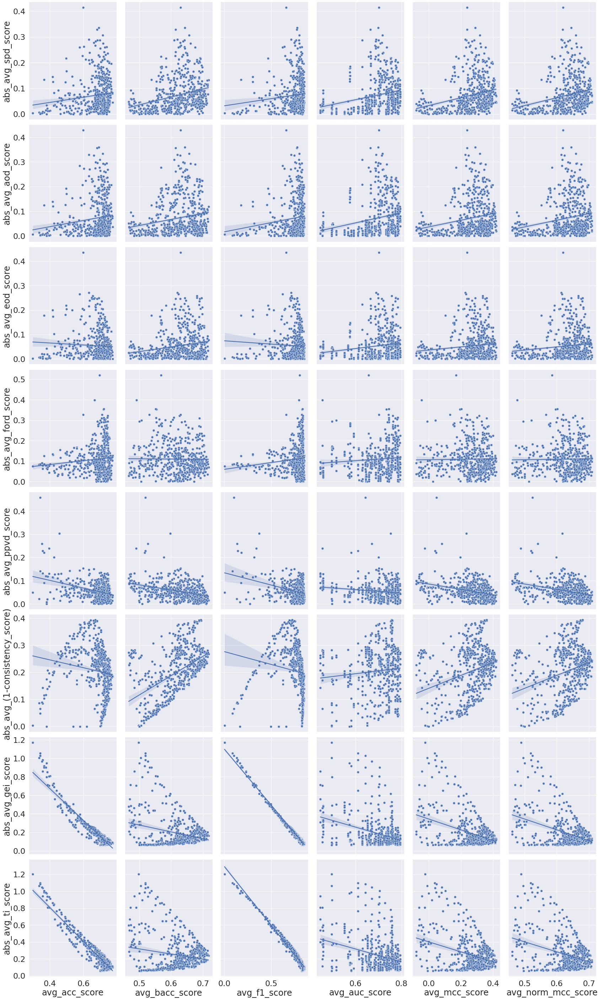

In [22]:
# Set plot font
plt.rcParams.update({'font.family':'serif'})
plt.rcParams.update({'font.serif':'Times New Roman'})

sns.set(font_scale = 2)
abs_fairness_metrics = ['abs_'+col for col in avg_fairness_metrics]
g = sns.pairplot(data=results_all_converted, x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
             height=5, aspect=.8, kind="reg")
g.map(sns.scatterplot)

#### 4.1.2 Base_estimator specific Results

We can see from the graphs below:
1. Different base_estimators can also generate very different results: 
    - SVM (red) the least robust, while "NB" manifest clear trend
    - base_estimators divided into two groups when it comes to consistency_score: tree-based, ensemble (trade-offs) vs non tree-based, non ensemble

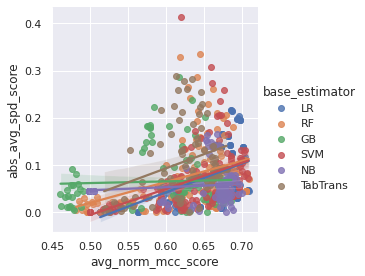

In [41]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, hue='base_estimator', height=4)

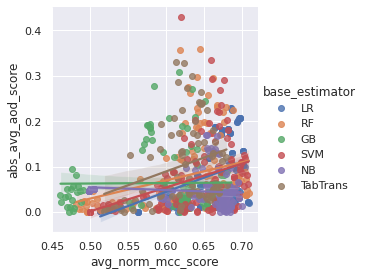

In [59]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y='abs_avg_aod_score', hue='base_estimator', height=4)

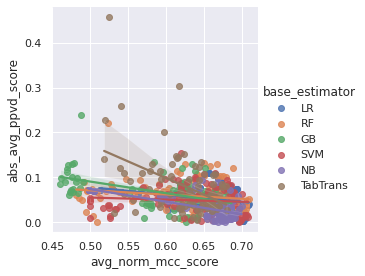

In [58]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y='abs_avg_ppvd_score', hue='base_estimator', height=4)

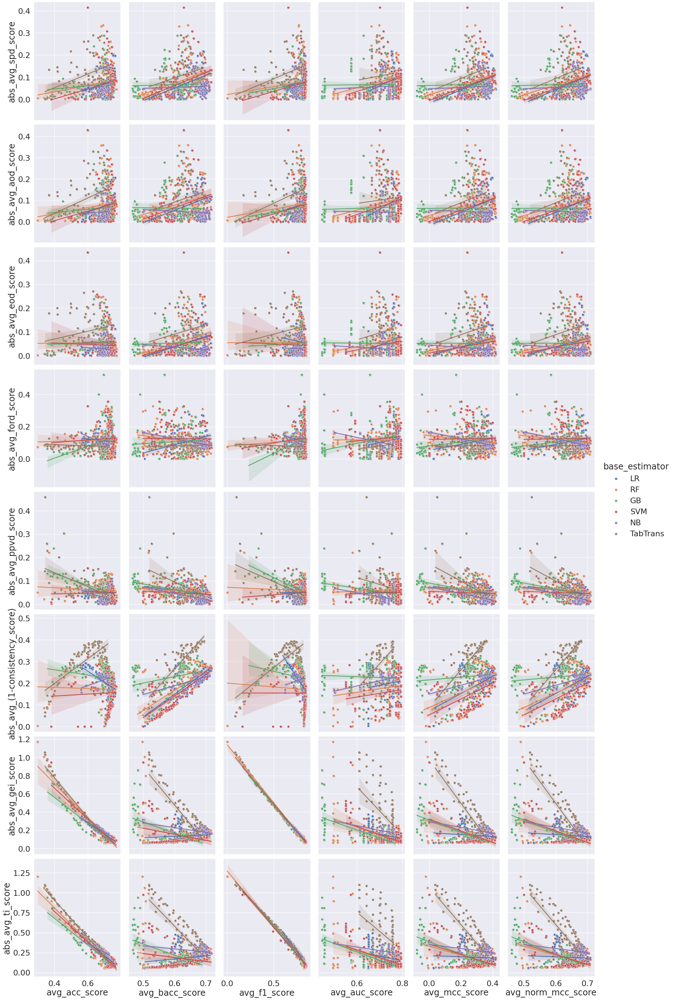

In [24]:
sns.set(font_scale = 2)
g = sns.pairplot(data=results_all_converted[results_all_converted.base_estimator!=''],
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='base_estimator')
g.map(sns.scatterplot)

LR


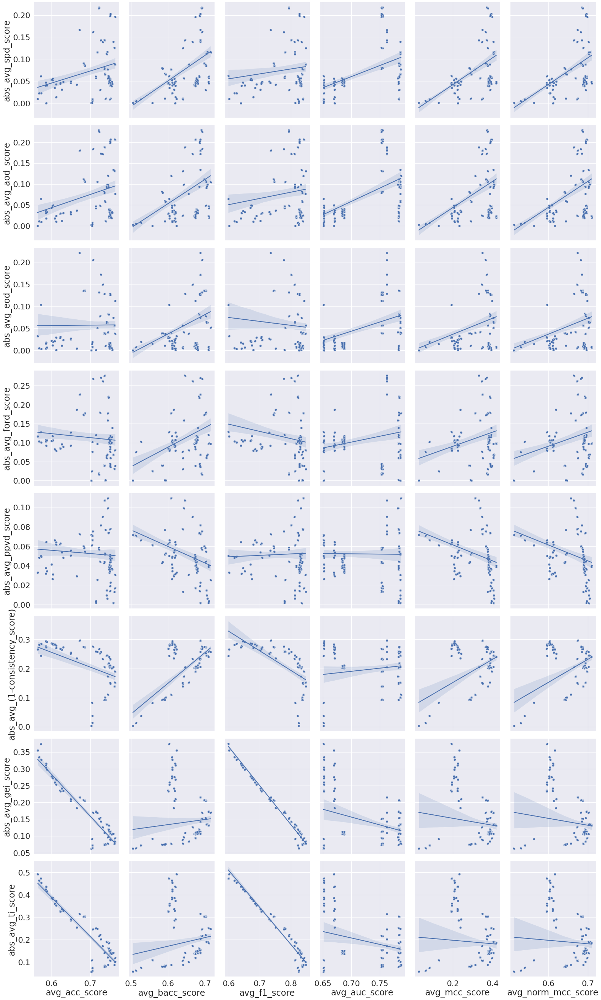

RF


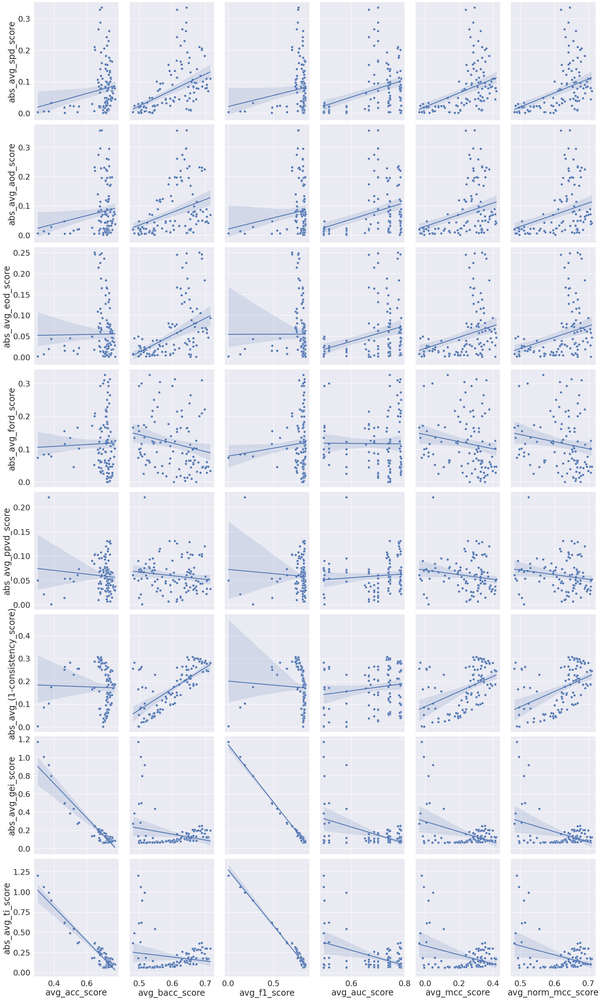

GB


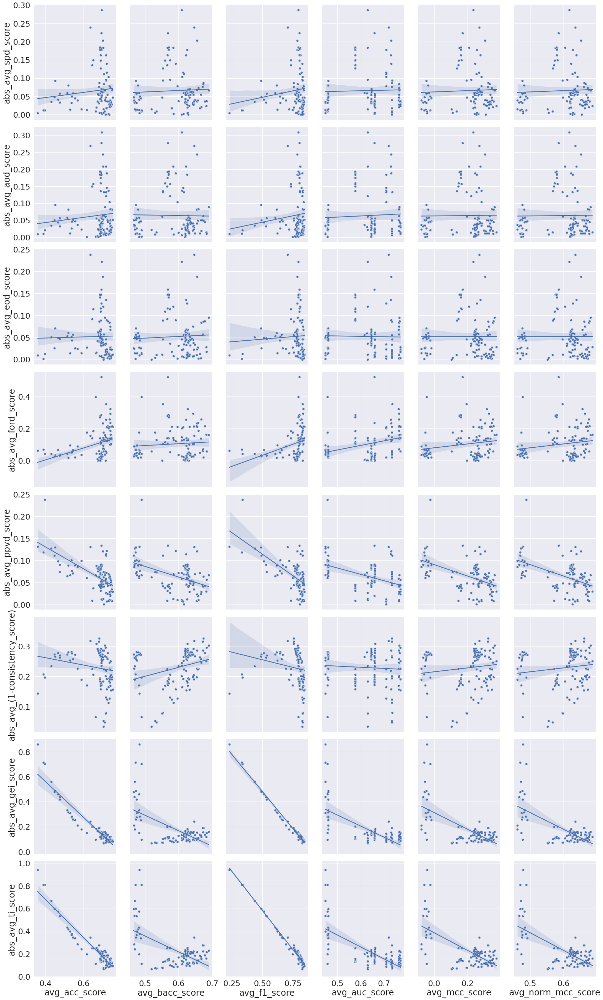

SVM


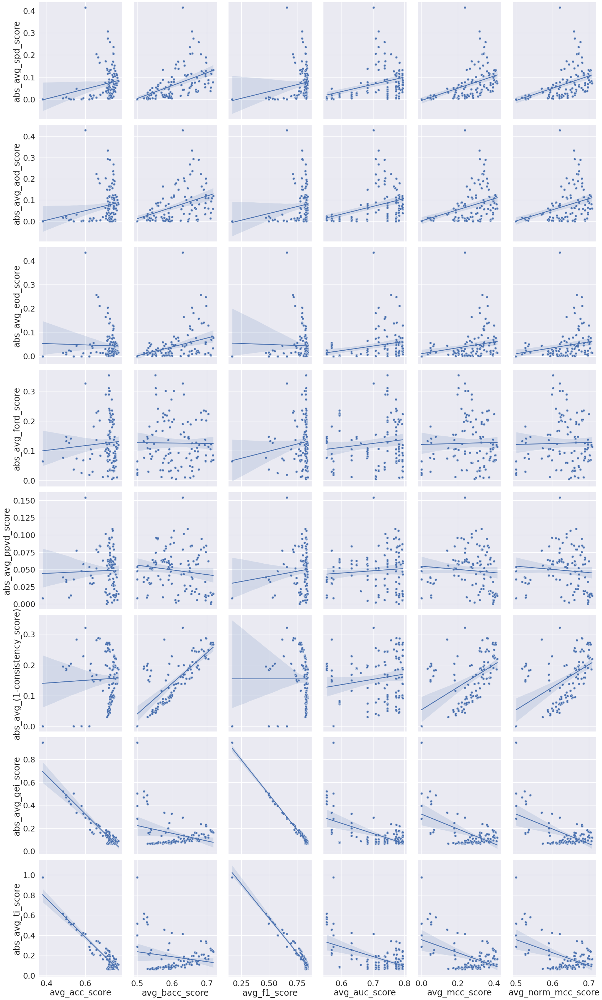

NB


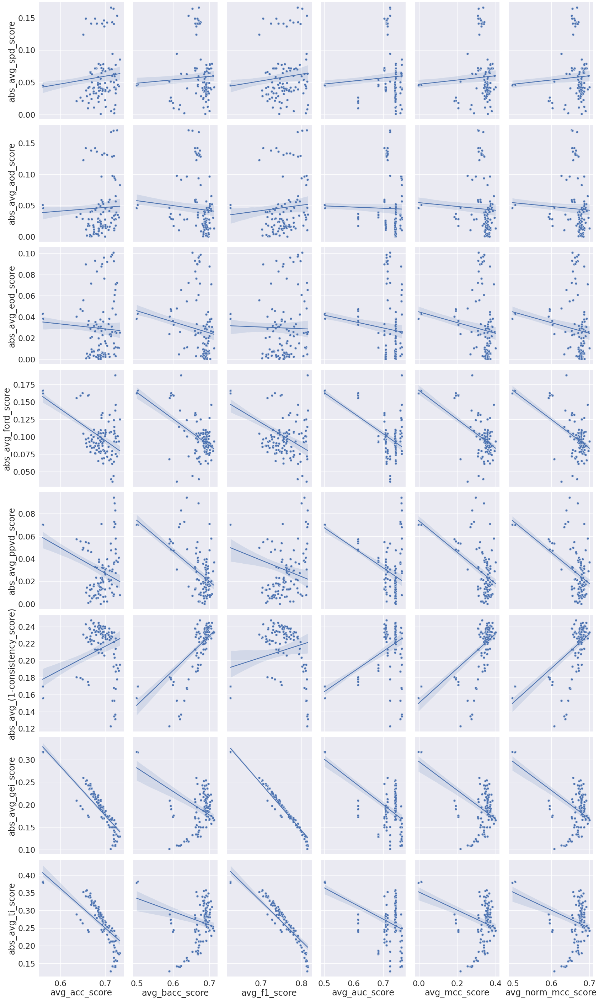

TabTrans


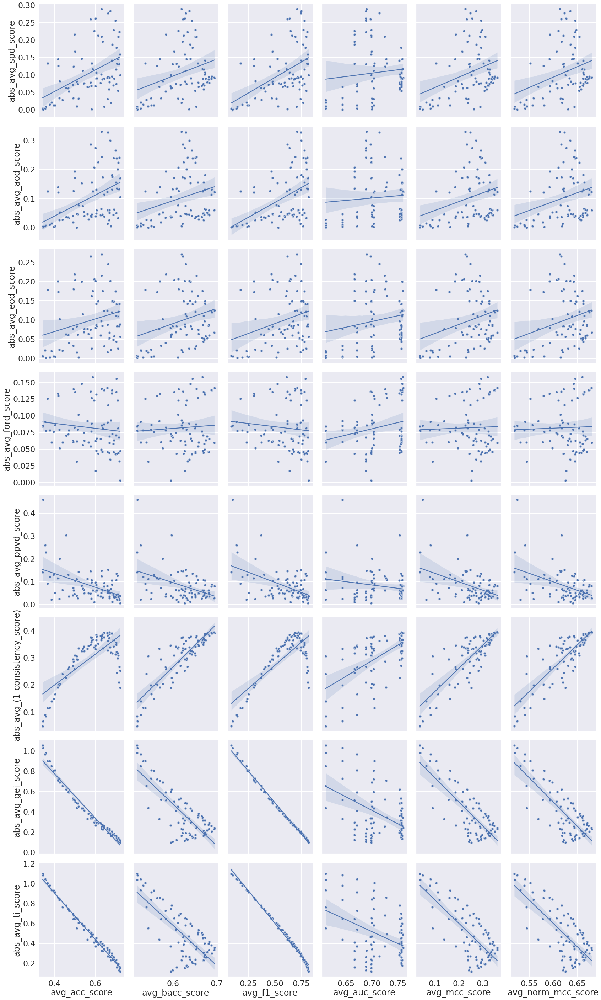

In [25]:
sns.set(font_scale = 2)
abs_fairness_metrics = ['abs_'+col for col in avg_fairness_metrics]
for base in results_all_converted.base_estimator.unique():
    print(base)
    if base=='':
        pass
    else:
        g = sns.pairplot(data=results_all_converted[results_all_converted.base_estimator==base],
                         x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                         height=5, aspect=.8, kind="reg")
        g.map(sns.scatterplot)
        plt.show()

#### 4.1.3 Threshold specific Results

We can see from the graphs below:
1. Using different threshold also yiels different results: 
    - most obvious with (f1_score, group_fairness) combinations

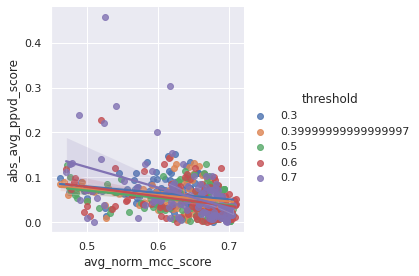

In [26]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, hue='threshold', height=4)

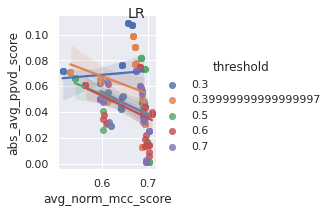

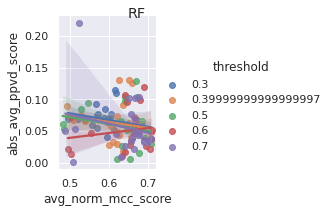

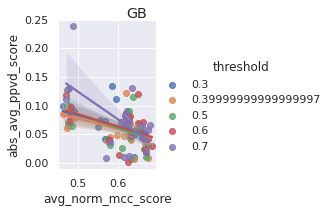

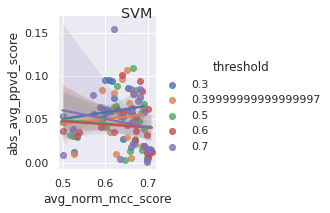

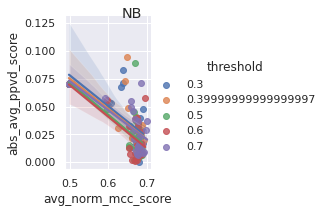

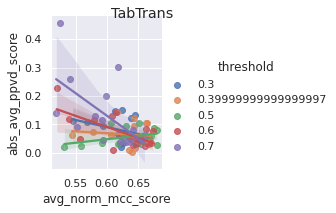

In [27]:
sns.set(font_scale = 1)
for base in results_all_converted.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x="avg_norm_mcc_score", y="abs_avg_ppvd_score", hue="threshold", height=3).fig.suptitle(base)

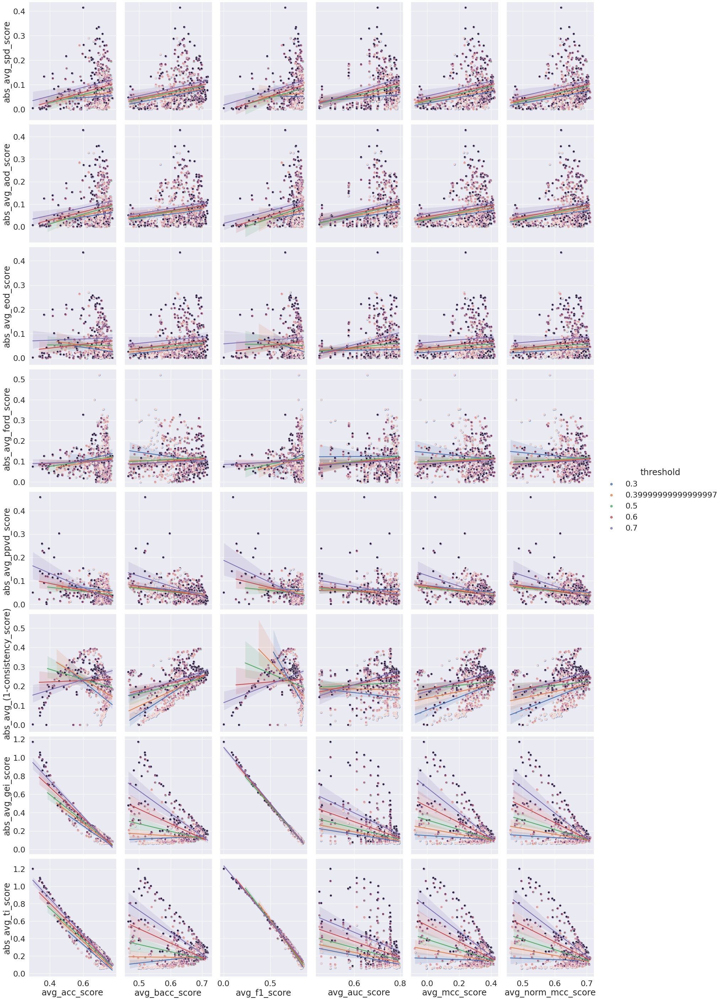

In [28]:
sns.set(font_scale = 2)
g = sns.pairplot(data=results_all_converted,
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='threshold')
g.map(sns.scatterplot)

#### 4.1.4 Bias_mitigation specific Results

We can see from the graphs below:
1. Results are clearly divided into two groups
2. Generally with wide C.I.

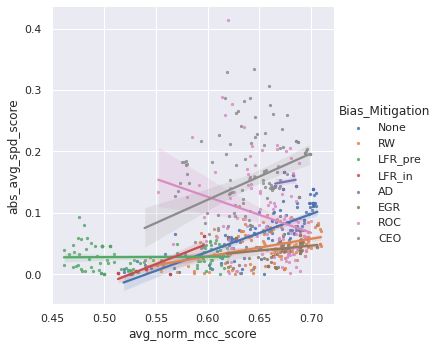

In [48]:
sns.set(font_scale = 1)
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, hue='Bias_Mitigation', 
               scatter_kws={'s': 5}, height=5)

In [29]:
results_all_converted['BM_Category'] = results_all_converted['Bias_Mitigation'].replace({v: k for k, l in bm_category.items()\
                                                                                         for v in l})
results_all_converted[['Bias_Mitigation','BM_Category']].drop_duplicates()

,Bias_Mitigation,BM_Category
0,None,None
5,RW,PRE
10,LFR_pre,PRE
15,LFR_in,IN
20,AD,IN
25,EGR,IN
30,ROC,POST
35,CEO,POST


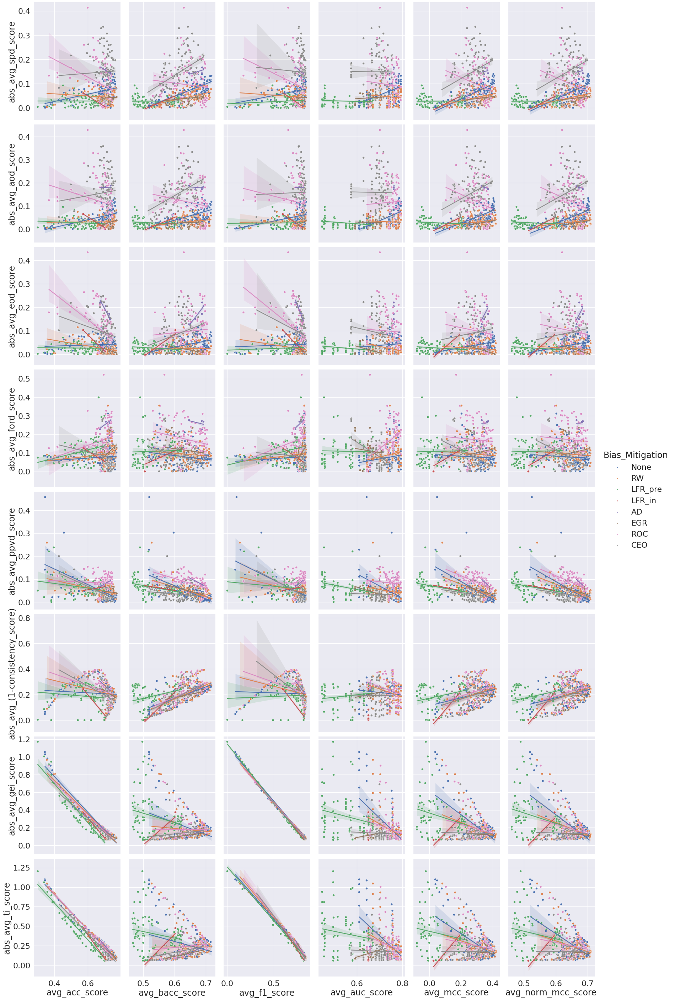

In [39]:
sns.set(font_scale = 2)
g = sns.pairplot(data=results_all_converted,
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='Bias_Mitigation', plot_kws={'scatter_kws': {'s': 2}})
g.map(sns.scatterplot)

In [31]:
# results_all_converted_try = results_all_converted.copy(deep=True).reset_index(drop=True)
# for i in results_all_converted_try.index:
#     if results_all_converted_try.loc[i, 'base_estimator'] == '':
#         results_all_converted_try.loc[i, 'base_estimator'] = results_all_converted_try.loc[i-1, 'base_estimator']
        
# results_all_converted_try.reset_index(drop=True).iloc[-30:,]

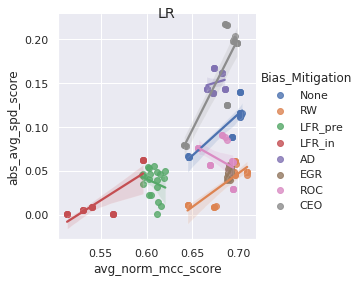

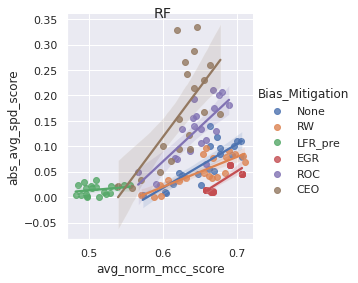

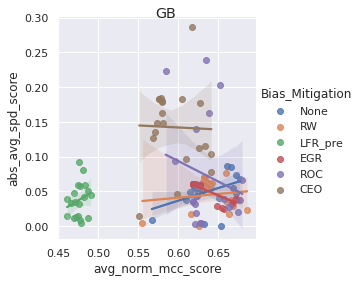

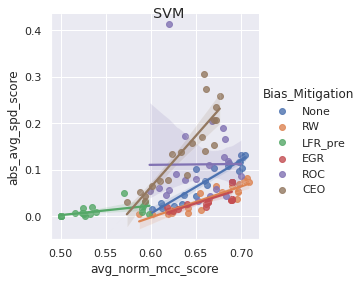

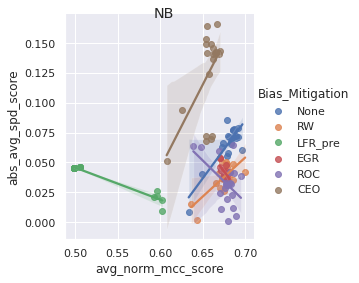

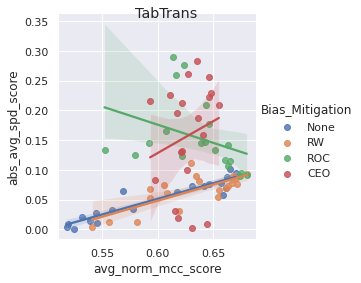

In [49]:
sns.set(font_scale = 1)
for base in results_all_converted.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x=ACC_METRIC, y=FAIR_METRIC, hue="Bias_Mitigation", height=4).fig.suptitle(base)

In [50]:
FAIR_METRIC

'abs_avg_spd_score'

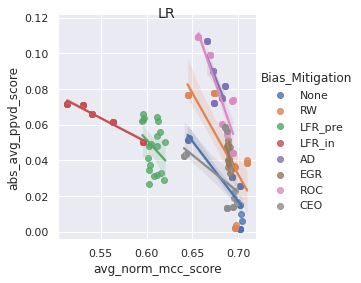

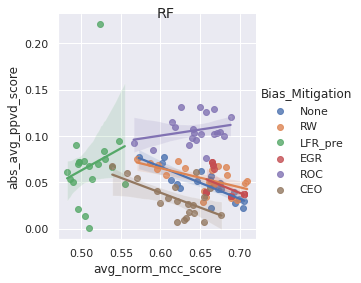

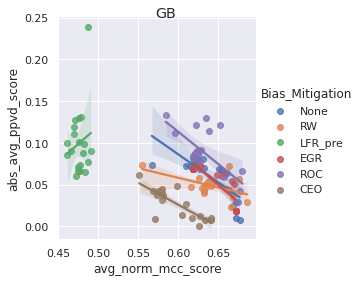

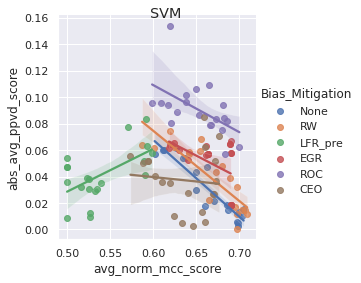

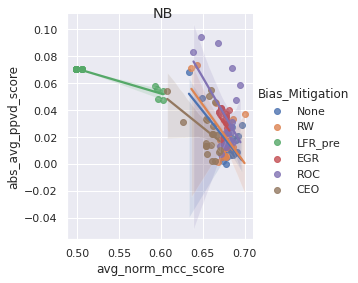

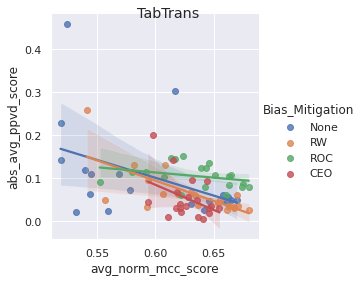

In [54]:
sns.set(font_scale = 1)
for base in results_all_converted.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x=ACC_METRIC, y='abs_avg_ppvd_score', hue="Bias_Mitigation", height=4).fig.suptitle(base)

##### Bias Mitigation Category

Pre- and post-processing always generate similar results, while in-processing is usually different:
    - less trade-offs between group fairness and accuracy
    - but trade-offs for "ford_score", which is the very g_fair metric showing no trade-offs in overall results

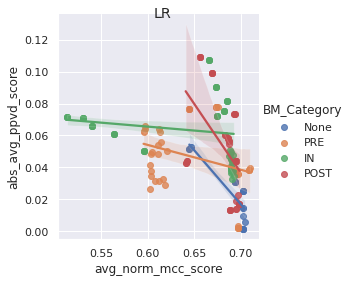

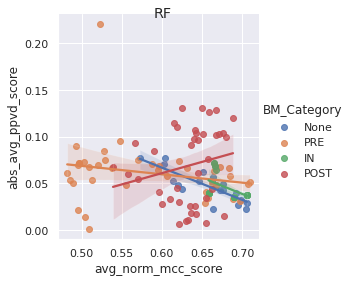

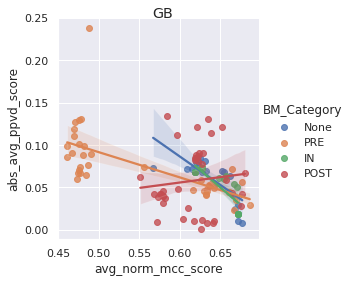

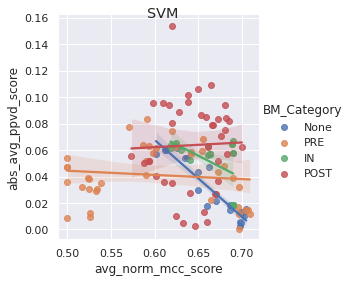

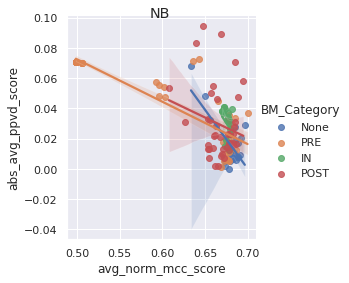

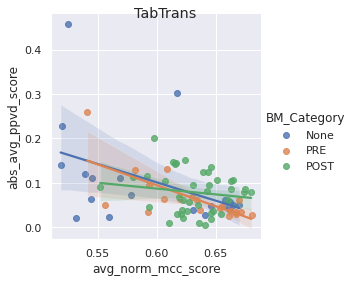

In [33]:
sns.set(font_scale = 1)
for base in results_all_converted.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x="avg_norm_mcc_score", y="abs_avg_ppvd_score", hue="BM_Category", height=4).fig.suptitle(base)

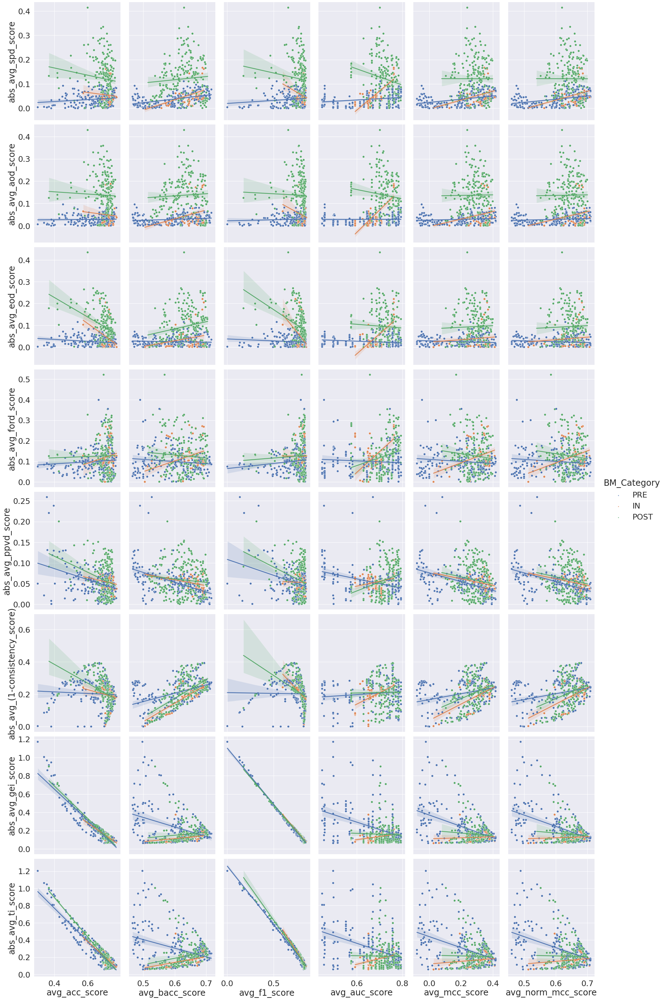

In [34]:
sns.set(font_scale = 2)
g = sns.pairplot(data=results_all_converted[results_all_converted.BM_Category!='None'],
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='BM_Category', plot_kws={'scatter_kws': {'s': 2}})
g.map(sns.scatterplot)

### 4.2 Group vs. Individual Fairness

No clear trend between group and individual fairness with a few exceptions

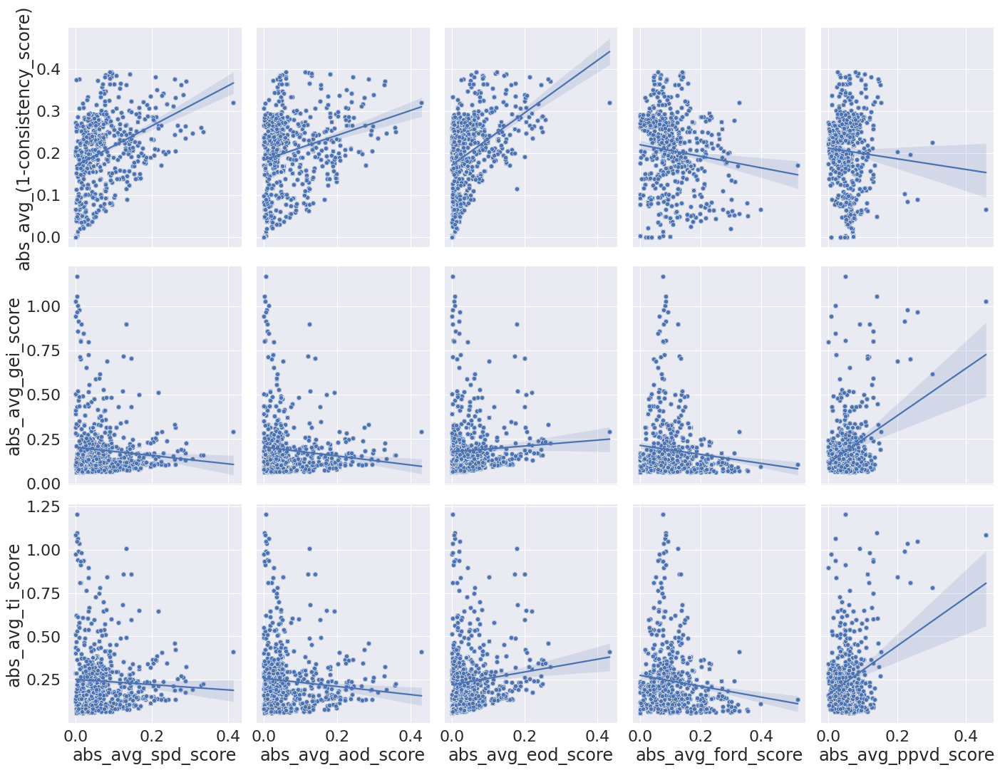

In [35]:
g = sns.pairplot(data=results_all_converted,
                 x_vars=['abs_avg_'+col for col in group_fairness], y_vars=['abs_avg_'+col for col in individual_fairness],
             height=5, aspect=.8, kind="reg")
g.map(sns.scatterplot)

#### 4.2.1 Heatmap

<AxesSubplot:>

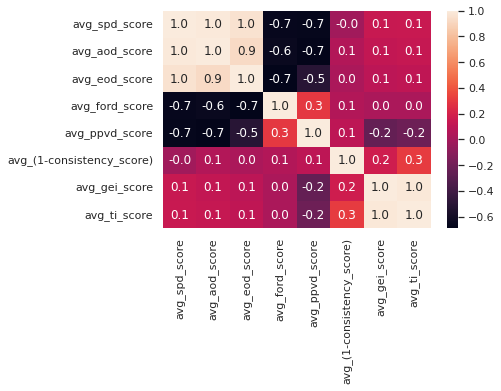

In [36]:
sns.set(font_scale = 1)
# avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
# avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]
sns.heatmap(results_all_converted[avg_fairness_metrics].corr(), annot=True, fmt=".1f")

<AxesSubplot:>

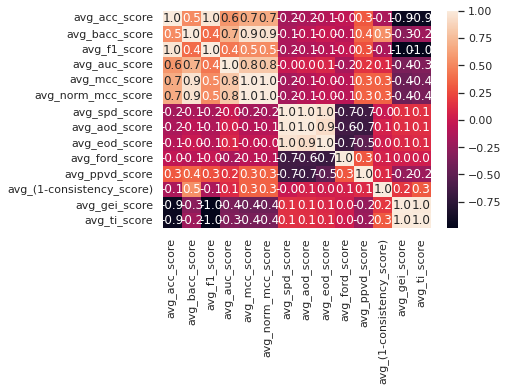

In [37]:
sns.set(font_scale = 1)
# avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
# avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]
sns.heatmap(results_all_converted[avg_accuracy_metrics+avg_fairness_metrics].corr(), annot=True, fmt=".1f")